In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import expit, logit
from joblib import Parallel, delayed
from tqdm.auto import tqdm
import multiprocessing as mp
from threading import Thread
from math import erf
from scipy import optimize
import scipy.stats as stats

c:\Users\digio\OneDrive\Documents\Francesco\Universita\Secondo Anno Magistrale\Online Learning Applications\Project\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Environment

In [12]:
class MultiProductPricingEnvironment:
    def __init__(self, products,
                 means,
                 covs,
                 seed=42,
                 plot_distribution=True,
                 mean_update_std = 0.05,
                 mean_clip = 2.0
                  ):
        self.products = products
        self.d = len(products)
        self.means, self.covs = self.delta_method_latent_from_logitnormal(means, covs)
        self.initial_means = self.means
        self.rng = np.random.default_rng(seed)
        self.mean_update_std = mean_update_std
        self.mean_clip = mean_clip
        self.current_vals = None

        if plot_distribution:
            n_samples = 100_000
            bins=100
            samples = self.sample_valuations(n_samples)
            for i, product in enumerate(products):

                plt.figure(figsize=(7, 3))
                plt.hist(samples[:, i], bins=bins, density=True)
                plt.title(f"Distribution of valuations for product {product} (100000 rounds)")
                plt.xlabel("valuation")
                plt.ylabel("density")
                plt.xlim(0, 1)
                plt.tight_layout()
                plt.show()

    def compute_Q(self, prices_grid, eps = 1e-12):

        dvs = np.sqrt(np.clip(np.diag(self.covs), 0.0, None))

        pc = np.clip(prices_grid, eps, 1 - eps)
        logits = np.log(pc / (1 - pc))

        Phi = lambda x: 0.5 * (1.0 + np.vectorize(erf)(x / np.sqrt(2.0)))
        z = (logits[None, :] - self.means[:, None]) / np.where(dvs > 0, dvs, 1.0)[:, None]
        Q = 1.0 - Phi(z)

        Q[:, prices_grid <= 0.0] = 1.0
        Q[:, prices_grid >= 1.0] = 0.0

        # If there are determinist prices (zero variance), set the prices above the valuation to 0 and 1 below
        det = dvs == 0.0
        if np.any(det):
            v = 1.0 / (1.0 + np.exp(-self.means[det]))
            Q[det] = (v[:, None] >= prices_grid[None, :]).astype(float)

        # Clip Q values to prevent them from being exactly zero
        Q = np.clip(Q, eps, 1.0 - eps)

        return Q

    @staticmethod
    def delta_method_latent_from_logitnormal(m, C):
        """
        Approximate latent Gaussian parameters (mu, Sigma_Z) for a multivariate logit-normal
        with desired mean vector m in (0,1)^d and covariance C.

        Uses first-order delta method:
            J = diag( m_i * (1 - m_i) )
            Sigma_Z ≈ J^{-1} C J^{-1}
            mu ≈ logit(m)
        """
        m = np.asarray(m, dtype=float)
        C = np.asarray(C, dtype=float)
        if m.ndim != 1:
            raise ValueError("m must be a 1-D array of means in (0,1).")
        if C.shape != (m.size, m.size):
            raise ValueError("C must be a square matrix with same dimension as m.")
        if np.any((m <= 0) | (m >= 1)):
            raise ValueError("All entries of m must lie strictly in (0,1).")

        mu = logit(m)
        gprime = m * (1.0 - m)  # derivative of expit at mu where expit(mu)=m
        if np.any(gprime <= 0):
            raise ValueError("Means too close to 0 or 1 make the delta method unstable.")
        Jinv = np.diag(1.0 / gprime)
        Sigma_Z = Jinv @ C @ Jinv
        # Symmetrize small numerical asymmetry
        Sigma_Z = 0.5 * (Sigma_Z + Sigma_Z.T)
        return mu, Sigma_Z

    def update_means(self):
        """
        Drift the latent logit means over time with Gaussian noise.
        This keeps the model internally consistent.
        """
        if self.means is None:
            raise ValueError("self.means is None. Did you initialize the environment correctly?")

        noise = self.rng.normal(0.0, self.mean_update_std, size=self.d)
        self.means += noise
        # self.means = np.clip(self.means, self.initial_means - self.mean_clip, self.initial_means + self.mean_clip)

    def sample_valuations(self, n=1):
        z = self.rng.multivariate_normal(self.means, self.covs, size=n)
        vals = expit(z)
        if n == 1:
            self.current_vals = vals.ravel()
        else:
            self.current_vals = vals
        return self.current_vals

    def round(self, chosen_prices):
        chosen_prices_arr = np.array([chosen_prices[p] for p in self.products], dtype=float)
        vals = self.sample_valuations()
        print(vals)
        sold = (vals >= chosen_prices_arr).astype(int)
        reward = np.multiply(chosen_prices_arr, sold)
        print(reward, sold)
        self.update_means()
        return reward, sold

    def get_current_vals(self):
        """Return last sampled valuations (all environments support this now)."""
        return self.current_vals

In [13]:
class PricingEnvironmentWrapper:
    def __init__(self, products,
                mean=None, cov=None,
                seed=None):
        self.products = products
        self.d = len(products)

        if mean is None or cov is None:
                raise ValueError("Logit-Normal requires mean and cov.")
        self.env = MultiProductPricingEnvironment(products, mean, cov, seed)
        
    def round(self, chosen_prices):
        reward, sold = self.env.round(chosen_prices)
        return reward, sold

    def compute_Q(self, prices_grid):
        if not hasattr(self.env, "compute_Q"):
            raise NotImplementedError(f"{self.env_type} environment does not implement compute_Q")
        return self.env.compute_Q(prices_grid)

    def get_products(self):
        return self.products

    def get_current_vals(self):
        """Return last sampled valuations (all environments support this now)."""
        return self.env.current_vals
    
    def get_current_alpha(self):
        return self.env.get_current_alpha()
    
    def get_means(self):
        return self.env.means

### Agent

In [14]:
class DiscountedEXP3PAgent:
    """
    EXP3.P agent with discounting for non-stationary rewards.
    """
    def __init__(self, K, T, alpha, gamma, discount=0.99):
        self.K = K
        self.T = T
        self.alpha = alpha
        self.gamma = gamma
        self.discount = discount
        self.t = 0

        self.weights = np.ones(K, dtype=float)
        self.probs = np.ones(K) / K
        self.a_t = None

    def pull_arm(self):
        # Probability distribution with smoothing
        wsum = np.sum(self.weights)
        if wsum <= 0:
            # numerical fallback
            self.weights = np.ones_like(self.weights)
            wsum = np.sum(self.weights)

        self.probs = (1 - self.gamma) * (self.weights / wsum) + (self.gamma / self.K)
        self.probs = np.clip(self.probs, 1e-12, 1.0)
        self.probs /= np.sum(self.probs)
        self.a_t = np.random.choice(self.K, p=self.probs)
        return self.a_t

    def update(self, reward):
        """
        reward: scaled to [0,1]
        """
        i = self.a_t
        self.t += 1

        # Discount past weights
        self.weights *= self.discount

        # Unbiased estimator
        x_hat = np.zeros(self.K)
        x_hat[i] = reward / max(self.probs[i], 1e-12)
        # Bias correction
        x_hat += self.alpha / (np.sqrt(self.K * self.T) * np.clip(self.probs, 1e-12, 1.0))
        # print(x_hat)

        # Weight update (multiplicative)
        exponent = (self.gamma / self.K) * x_hat
        # To avoid overflow, clip exponent
        exponent = np.clip(exponent, -700, 700)
        self.weights *= np.exp(exponent)

        # Numerical safety
        self.weights = np.clip(self.weights, 1e-12, 1e300)
        # print(self.weights)

    def get_probs(self):
        """
        Return the current probability distribution over arms.
        """
        return self.probs.copy()    

In [15]:
class PrimalDualPricingAgent:
    """
    Primal-dual agent for multi-product pricing with inventory constraints.
    Uses Discounted EXP3.P per product.
    """
    def __init__(self, products, prices, budget, T, eta, K, discount=1.0, log_history=True):
        self.products = list(products)
        self.prices = prices
        self.K = K
        self.T = T
        self.budget = budget
        self.initial_budget = budget
        self.eta = eta
        self.discount = discount
        self.lmbd = 1.0
        self.t = 0
        self.rho = self.initial_budget / self.T
        self.lambda_max = 1.0
        self.counts = {}
        self.log_history = log_history
        self.p_max = max(max(v) for v in prices.values()) if len(prices) > 0 else 1.0
        # cost is in {0,1} per your description => c_max = 1
        self.c_max = 1.0
        # L in [-lambda_max, p_max] -> use O = lambda_max, U = p_max + lambda_max
        self.O = self.lambda_max
        self.U = self.p_max + self.lambda_max
        self.lambda_smooth = 0.1

        self.agents = {}
        for p in self.products:
            Kp = len(self.prices[p])
            # set sensible defaults for alpha/gamma, but allow customization by caller if desired
            #alpha = 2.0 * np.sqrt(Kp * T)
            delta = 0.1
            # alpha = np.sqrt(np.log(Kp)/T)
            # gamma typical scaling: min(3/5, 2 * sqrt((3*K*logK)/(5*T)))
            alpha = 2.0 * np.sqrt(np.log((Kp*T)/delta))
            gamma = min(3/5, 2.0 * np.sqrt((3.0 * Kp * np.log(max(Kp,2))) / (5.0 * max(1, T))))
            self.agents[p] = DiscountedEXP3PAgent(K=Kp, T=T, alpha=alpha, gamma=gamma, discount=self.discount)
            self.counts[p] = np.zeros(Kp, dtype=int)

        if self.log_history:
            self.history = {
                "lambda": [],
                "chosen_prices": [],
                "probs": {p: [] for p in self.products}
            }

        self.price_indices = {p: 0 for p in products}

    def pull_prices(self):
        chosen_prices_idx = {}
        for p, agent in self.agents.items():
            if self.budget <= 0:
                chosen_prices_idx[p] = -1
            else:
                chosen_prices_idx[p] = agent.pull_arm()
                self.counts[p][chosen_prices_idx[p]] += 1
        self.price_indices = chosen_prices_idx

        chosen_prices = {p: self.prices[p][idx] if idx >= 0 else idx
                         for p, idx in chosen_prices_idx.items()}
        
        if self.log_history:
            self.history["lambda"].append(self.lmbd)
            self.history["chosen_prices"].append(chosen_prices)
            for p in self.products:
                self.history["probs"][p].append(self.agents[p].get_probs().copy())
        return chosen_prices

    def update(self, rewards, costs):
        self.t += 1
        rewards = np.asarray(rewards, dtype=float)
        costs = np.asarray(costs, dtype=float)

        # Total cost across products this round
        total_cost = np.sum(costs)
        avg_cost_per_product = total_cost / max(1, len(self.products))

        lmbd_candidate = self.lmbd + self.eta * (avg_cost_per_product - self.rho)
        self.lmbd = (1 - self.lambda_smooth) * self.lmbd + self.lambda_smooth * np.clip(lmbd_candidate, 0.0, self.lambda_max)

        # For each product compute L and send the fixed normalized L_scaled in [0,1] to that product's agent
        for i, p in enumerate(self.products):
            idx = self.price_indices[p]
            if idx < 0:
                # wasn't selected (budget exhausted), skip update for this product
                continue

            # raw Lagrangian reward for this product
            L = rewards[i] - self.lmbd * (costs[i] -self.rho)  # reward in [-lambda_max, p_max]

            # fixed normalization to [0,1]
            L_scaled = (L + self.O) / self.U
            L_scaled = float(np.clip(L_scaled, 0.0, 1.0))

            # update the per-product EXP3.P agent with normalized reward
            self.agents[p].update(L_scaled)

        # Deduct realized cost from remaining budget
        self.budget -= total_cost
        # ensure budget doesn't go negative
        self.budget = max(self.budget, 0.0)

    def get_history(self):
        return self.history
    
    def get_action_counts(self):
        return {p: self.counts[p].copy() for p in self.products}

    def print_latest_probs(self):
        print(f"Round {self.t}, lambda={self.lmbd:.3f}")
        for p in self.products:
            probs = self.agents[p].get_probs()
            print(f"Product {p}:")
            for price, prob in zip(self.prices[p], probs):
                print(f"  price={price:.2f}, prob={prob:.3f}")
        print("-"*40)    


### Baseline

In [16]:
def compute_clairvoyant_multi_slack(products, prices_grid, env, rho, lambda_slack=1e3, verbose=False):
    """
    Clairvoyant LP for multiple products with global sales constraint.
    If infeasible, falls back to slack-variable version.

    Args:
        products: list of product names
        prices_grid: 1D array of candidate prices (same for all products)
        env: MultiProductPricingEnvironment (has compute_Q)
        rho: global expected total sales per round
        cost: optional unit cost
        lambda_slack: penalty weight for slack variable (fallback mode)
        verbose: print debug info

    Returns:
        gamma: dict product -> array of probabilities over prices
        expected_reward: float
        expected_total_sales: float
        slack: float (0 in strict mode, >=0 in fallback mode)
        fallback_used: bool
    """
    prices_grid = np.array(prices_grid)
    num_products = env.d
    num_prices = len(prices_grid)

    # Compute sale probabilities analytically
    Q = env.compute_Q(prices_grid)  # shape: num_products × num_prices
    all_prices = np.tile(prices_grid, num_products)
    all_qs = Q.flatten()

    # ---------- Strict version ----------
    c = - (all_prices) * all_qs
    A_ub = [all_qs]
    b_ub = [rho]

    A_eq = []
    b_eq = []
    for i in range(num_products):
        row = np.zeros_like(all_prices)
        row[i*num_prices:(i+1)*num_prices] = 1.0
        A_eq.append(row)
        b_eq.append(1.0)
    A_eq = np.array(A_eq)
    b_eq = np.array(b_eq)

    bounds = [(0, 1)] * len(all_prices)

    res = optimize.linprog(c, A_ub=A_ub, b_ub=b_ub,
                           A_eq=A_eq, b_eq=b_eq,
                           bounds=bounds, method='highs')

    if res.success:
        gamma = {}
        for i, p in enumerate(products):
            gamma[p] = res.x[i*num_prices:(i+1)*num_prices]
        expected_reward = -res.fun
        expected_total_sales = np.sum(all_qs * res.x)
        slack = 0.0
        fallback_used = False
        return gamma, expected_reward, expected_total_sales, slack, fallback_used

    if verbose:
        print("Strict LP infeasible. Falling back to slack version. Status:", res.status, res.message)

    # ---------- Slack fallback version ----------
    num_vars = num_products * num_prices + 1  # gamma + slack
    c = np.zeros(num_vars)
    c[:-1] = - (all_prices) * all_qs
    c[-1] = lambda_slack  # penalty

    A_ub = np.zeros((1, num_vars))
    A_ub[0, :-1] = all_qs
    A_ub[0, -1] = -1.0
    b_ub = [rho]

    A_eq = np.zeros((num_products, num_vars))
    b_eq = np.ones(num_products)
    for i in range(num_products):
        A_eq[i, i*num_prices:(i+1)*num_prices] = 1.0

    bounds = [(0, 1)] * (num_vars - 1) + [(0, None)]

    res = optimize.linprog(c, A_ub=A_ub, b_ub=b_ub,
                           A_eq=A_eq, b_eq=b_eq,
                           bounds=bounds, method='highs')

    gamma = {}
    slack = None
    if res.success:
        for i, p in enumerate(products):
            gamma[p] = res.x[i*num_prices:(i+1)*num_prices]
        slack = res.x[-1]
        expected_reward = -res.fun
        expected_total_sales = np.sum(all_qs * res.x[:-1])
        fallback_used = True
    else:
        gamma = {p: np.zeros(num_prices) for p in products}
        expected_reward = 0.0
        expected_total_sales = 0.0
        slack = np.inf
        fallback_used = True
        if verbose:
            print("Even slack LP did not converge. Status:", res.status, res.message)

    return gamma, expected_reward, expected_total_sales, slack, fallback_used

In [17]:
def compute_best_fixed_distribution_hind_slack(products, prices_grid, Qs, T, rho, cost=0.0, allow_slack=True):
    """
    Compute hindsight-optimal fixed distribution over prices across entire env trajectory,
    optionally with a slack variable for sales constraint relaxation.

    Args:
        products: list of product names
        prices_grid: 1D array of candidate prices (same for all products)
        Qs: list of demand matrices (each shaped num_products x num_prices)
        T: number of rounds (len(Qs))
        rho: expected total sales constraint (per round, on average)
        cost: optional unit cost
        allow_slack: if True, relax sales constraint with penalized slack variable

    Returns:
        gamma: dict of product -> distribution over prices
        expected_reward: hindsight optimal total expected reward (averaged per round)
        expected_total_sales: hindsight optimal average sales
        slack_value: amount by which sales constraint was relaxed
                     (0 if not needed, None if allow_slack=False or solver failed)
    """
    num_products = len(products)
    num_prices = len(prices_grid)

    # Flatten decision variables: gamma_{i,j} for all products & prices
    all_prices = np.tile(prices_grid, num_products)

    # Average Q over time
    avg_Q = sum(Qs) / T

    if allow_slack:
        # Add slack variable at the end
        num_vars = num_products * num_prices + 1

        # Objective: maximize revenue - penalty * slack
        avg_revenue_scale = np.mean((all_prices - cost) * avg_Q.flatten())
        big_penalty = 0.01 * avg_revenue_scale


        c = np.zeros(num_vars)
        c[:-1] = - (all_prices - cost) * avg_Q.flatten()
        c[-1] = big_penalty   # penalize slack

        # Sales constraint with slack
        A_ub = [np.append(avg_Q.flatten(), 1.0)]
        b_ub = [rho]

        # Per-product normalization
        A_eq = []
        b_eq = []
        for i in range(num_products):
            row = np.zeros(num_vars)
            row[i*num_prices:(i+1)*num_prices] = 1.0
            A_eq.append(row)
            b_eq.append(1.0)
        A_eq = np.array(A_eq)
        b_eq = np.array(b_eq)

        # Bounds: gamma ∈ [0,1], slack ≥ 0
        bounds = [(0, 1)] * (num_products * num_prices) + [(0, None)]

    else:
        # Strict version (no slack)
        num_vars = num_products * num_prices

        # Objective: maximize revenue
        c = - (all_prices - cost) * avg_Q.flatten()

        # Sales constraint (strict)
        A_ub = [avg_Q.flatten()]
        b_ub = [rho]

        # Per-product normalization
        A_eq = []
        b_eq = []
        for i in range(num_products):
            row = np.zeros(num_vars)
            row[i*num_prices:(i+1)*num_prices] = 1.0
            A_eq.append(row)
            b_eq.append(1.0)
        A_eq = np.array(A_eq)
        b_eq = np.array(b_eq)

        # Bounds: gamma ∈ [0,1]
        bounds = [(0, 1)] * num_vars

    # Solve LP
    res = optimize.linprog(c, A_ub=A_ub, b_ub=b_ub,
                           A_eq=A_eq, b_eq=b_eq,
                           bounds=bounds, method='highs')

    gamma = {}
    if res.success:
        for i, p in enumerate(products):
            gamma[p] = res.x[i*num_prices:(i+1)*num_prices]

        expected_reward = -res.fun

        if allow_slack:
            expected_total_sales = np.sum(avg_Q.flatten() * res.x[:-1])
            slack_value = res.x[-1]
        else:
            expected_total_sales = np.sum(avg_Q.flatten() * res.x)
            slack_value = None
    else:
        gamma = {p: np.ones(num_prices) / num_prices for p in products}
        expected_reward = 0.0
        expected_total_sales = 0.0
        slack_value = None
        print("Best fixed LP failed:", res.status, res.message)



    print(f"Gamma: {gamma}")

    return gamma, expected_reward, expected_total_sales, slack_value


### Parallelization

In [18]:
def _progress_listener(q, n_trials, leave=False):
    """
    Render one tqdm bar per trial in the main process.
    Workers send ('init', trial_idx, total), ('update', trial_idx, n), ('close', trial_idx, 0).
    """
    bars = {}
    closed = set()
    while len(closed) < n_trials:
        msg = q.get()
        if msg is None:  # termination signal
            break
        kind, trial_idx, val = msg
        if kind == 'init':
            # Create the bar for this trial if not exists
            if trial_idx not in bars:
                bars[trial_idx] = tqdm(total=int(val),
                                       desc=f"Trial {trial_idx+1}",
                                       position=trial_idx,
                                       leave=leave)
        elif kind == 'update':
            if trial_idx in bars:
                bars[trial_idx].update(int(val))
        elif kind == 'close':
            if trial_idx in bars and trial_idx not in closed:
                bars[trial_idx].close()
                closed.add(trial_idx)

    # Ensure all bars are closed
    for tid, bar in bars.items():
        if tid not in closed:
            bar.close()

def _start_progress(n_trials, leave=False):
    mgr = mp.Manager()
    q = mgr.Queue()
    th = Thread(target=_progress_listener, args=(q, n_trials, leave), daemon=True)
    th.start()
    return q, th, mgr

# ----------------------------------------
# One trial (runs in a worker process)

def run_all_trials_parallel(seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1, leave=False):
    progress_q, progress_thread, mgr = _start_progress(len(seeds), leave=leave)
    try:
        results = Parallel(n_jobs=n_jobs, prefer="processes")(
            delayed(run_single_trial)(
                trial_idx, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed, progress_q
            )
            for trial_idx, seed in enumerate(seeds)
        )
    finally:
        # tell listener to exit if not already
        progress_q.put(None)
        progress_thread.join()
        mgr.shutdown()
    '''all_regrets = [np.cumsum(results[i][3]-results[i][0]) for i in range(len(results))]
    all_payments = [np.cumsum(results[i][2]) for i in range(len(results))]
    all_regret_fixed_hind = [np.cumsum(results[i][4]-results[i][0]) for i in range(len(results))]'''
    all_regrets = [np.cumsum(results[i][3] - results[i][0]) for i in range(len(results))]
    all_payments = [np.cumsum(results[i][2]) for i in range(len(results))]
    all_regret_fixed_hind = [np.cumsum(results[i][4] - results[i][0]) for i in range(len(results))]

    return all_regrets, all_payments, all_regret_fixed_hind


def run_single_trial(trial_idx, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=42, progress_q=None):
    if progress_q is not None:
        progress_q.put(('init', trial_idx, T))

    env = PricingEnvironmentWrapper(products, mean=means, cov=covs, seed=seed)
    # env = MultiProductPricingEnvironment(products, means, covs, seed)
    
    agent = PrimalDualPricingAgent(products, prices, budget, T, eta, K) 
    rho = budget / T

    Qs = []
    utilities = []
    clairv_util = []
    my_prices = []
    my_payments = []
    total_wins = 0
    t = T

    for u in range(T):
        Qs.append(env.compute_Q(prices_per_product))

        # Compute clairvoyant distribution
        _, exp_clairv_util, _,_,_ =  compute_clairvoyant_multi_slack(products, prices_per_product, env, rho)
        #_, exp_clairv_util = compute_multi_product_clairvoyant(products, env, rho, prices_per_product)

        # Handle cases where compute_clairvoyant_multi returns None
        if exp_clairv_util is None:
            clairv_util.append(0)
        else:
            clairv_util.append(exp_clairv_util)

        if agent.budget <= 0:
            t=u+1
            rewards = [0 for _ in products]
            costs = [0 for _ in products]
            chosen_prices = {p: min(prices[p]) for p in products}
        else:
            # Agent chooses prices
            chosen_prices = agent.pull_prices()

            # Environment interaction
            rewards, costs = env.round(chosen_prices)

            # Update agent
            agent.update(rewards, costs)

        # Logging
        utilities.append(sum(rewards))
        my_prices.append(chosen_prices)
        my_payments.append(sum(costs))
        total_wins += sum(costs)  

        if progress_q is not None:
            progress_q.put(('update', trial_idx, 1))

    print(f"Total # of Wins: {total_wins}")

    gamma_fixed_hind, exp_fixed_util_hind, exp_fixed_sales_hind, _ = compute_best_fixed_distribution_hind_slack(
               products, prices_per_product, Qs, T, rho)

    fixed_util_hind = []
    fixed_util_hind = np.full(T, exp_fixed_util_hind)

    if progress_q is not None:
        progress_q.put(('close', trial_idx, 0))

    return (
        np.array(utilities),
        my_prices,
        np.array(my_payments),
        np.array(clairv_util),
        np.array(fixed_util_hind),
        agent.get_history()
        )

In [19]:
def run_single_trial_viz(trial_idx, products, prices, prices_per_product, budget, T, eta, K,
                     means, covs, seed=42, progress_q=None,
                     visualize=True, n_viz_rounds=500):
    """
    Run a single trial of the pricing experiment with an agent in a non-stationary environment.

    Tracks actual agent behavior if visualize=True, including total revenue per round.
    """
    if progress_q is not None:
        progress_q.put(('init', trial_idx, T))

    # Initialize environment wrapper
    env = PricingEnvironmentWrapper(products, mean=means, cov=covs, seed=seed)
    # env = MultiProductPricingEnvironment(products, means, covs, seed)

    agent = PrimalDualPricingAgent(products, prices, budget, T, eta, K)    
    # Initialize the pricing agent
    
    rho = budget / T
    Qs = []
    utilities = []
    clairv_util = []
    my_prices = []
    my_payments = []
    total_wins = 0
    t = T

    # Histories for visualization
    if visualize:
        sampled_vals_history = np.zeros((n_viz_rounds, len(products)))
        sold_history = np.zeros((n_viz_rounds, len(products)))
        price_history = np.zeros((n_viz_rounds, len(products)))
        revenue_history = np.zeros(n_viz_rounds)
        alpha_history = None
        mean_history = None
        if hasattr(env.env, "means"):
            mean_history = np.zeros((n_viz_rounds, len(products)))

    for u in range(T):

        Qs.append(env.compute_Q(prices_per_product))

        # Compute clairvoyant distribution
        _, exp_clairv_util, _,_,_ =  compute_clairvoyant_multi_slack(products, prices_per_product, env, rho)

        # Handle cases where compute_clairvoyant_multi returns None
        if exp_clairv_util is None:
            clairv_util.append(0)
        else:
            clairv_util.append(exp_clairv_util)

        if agent.budget <= 0:
            t=u+1
            rewards = [0 for _ in products]
            costs = [0 for _ in products]
            chosen_prices = {p: min(prices[p]) for p in products}
        else:
            # Agent chooses prices
            chosen_prices = agent.pull_prices()

            # Environment interaction
            rewards, costs = env.round(chosen_prices)

            # Update agent
            agent.update(rewards, costs)

        # Logging
        utilities.append(sum(rewards))
        my_prices.append(chosen_prices)
        my_payments.append(sum(costs))
        total_wins += sum(costs)  

        # Track histories for visualization
        if visualize and u < n_viz_rounds:
            for i, p in enumerate(products):
                price_history[u, i] = chosen_prices[p]
            sold_history[u, :] = (np.array(rewards) > 0).astype(int)
            sampled_vals_history[u, :] = env.get_current_vals()
            revenue_history[u] = sum(rewards)
            if alpha_history is not None:
                alpha_history[u, :] = env.get_current_alpha()
            if mean_history is not None:
                mean_history[u, :] = env.get_means()

        if progress_q is not None:
            progress_q.put(('update', trial_idx, 1))

    print(f"Total # of Wins: {total_wins}")


    gamma_fixed_hind, exp_fixed_util_hind, exp_fixed_sales_hind, _ = compute_best_fixed_distribution_hind_slack(
               products, prices_per_product, Qs, T, rho)

    fixed_util_hind = []
    fixed_util_hind = np.full(T, exp_fixed_util_hind)

    if progress_q is not None:
        progress_q.put(('close', trial_idx, 0))

    # Visualization of actual agent behavior
    if visualize:
        import matplotlib.pyplot as plt

        if alpha_history is not None:
            plt.figure(figsize=(12, 4))
            for i, p in enumerate(products):
                plt.plot(alpha_history[:, i], label=f"alpha_{p}")
            plt.title("Alpha evolution over time (Dirichlet)")
            plt.xlabel("Round")
            plt.ylabel("Alpha values")
            plt.legend()
            plt.show()

        if mean_history is not None:
            plt.figure(figsize=(12, 4))
            for i, p in enumerate(products):
                plt.plot(mean_history[:, i], label=f"mean_{p}")
            plt.title("Mean evolution over time (Logit-Normal)")
            plt.xlabel("Round")
            plt.ylabel("Mean values")
            plt.legend()
            plt.show()

        # Sampled valuations
        plt.figure(figsize=(12, 4))
        for i, p in enumerate(products):
            plt.plot(sampled_vals_history[:, i], label=f"sampled_val_{p}")

        plt.title("Sampled valuations over time")
        plt.xlabel("Round")
        plt.ylabel("Valuation")
        plt.ylim(0, 1)
        plt.legend()
        plt.show()


    return (
        np.array(utilities),
        my_prices,
        np.array(my_payments),
        np.array(clairv_util),
        np.array(fixed_util_hind),
        agent.get_history()
        )

In [20]:
def run_single_trial_horizon(trial_idx, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=42, progress_q=None):
    if progress_q is not None:
        progress_q.put(('init', trial_idx, T))

    # env = MultiProductPricingEnvironment(products, means, covs, seed)
    env = PricingEnvironmentWrapper(products, mean=means, cov=covs, seed=seed)

    
    agent = PrimalDualPricingAgent(products, prices, budget, T, eta, K) 
    rho = budget / T

    Qs = []
    utilities = []
    clairv_util = []
    my_prices = []
    my_payments = []
    instantaneous_regret = []  # Store instantaneous regret at each round
    instantaneous_regret_fixed = []  # Store instantaneous regret vs fixed hindsight
    total_wins = 0
    actual_rounds = T  # Default to T, but may be less if budget runs out

    for u in range(T):
        Qs.append(env.compute_Q(prices_per_product))

        # Compute clairvoyant distribution
        _, exp_clairv_util, _,_,_ = compute_clairvoyant_multi_slack(products, prices_per_product, env, rho)
        if exp_clairv_util is None:
            clairv_util.append(0)
        else:
            clairv_util.append(exp_clairv_util)

        # Check if budget is exhausted
        if agent.budget <= 0:
            actual_rounds = u  # Budget exhausted at round u
            break  # Exit the loop early

        # Agent chooses prices
        chosen_prices = agent.pull_prices()

        # Environment interaction
        rewards, costs = env.round(chosen_prices)

        # Update agent
        agent.update(rewards, costs)

        # Logging
        utility = sum(rewards)
        utilities.append(utility)
        my_prices.append(chosen_prices)
        payment = sum(costs)
        my_payments.append(payment)
        total_wins += payment
        
        # Calculate instantaneous regrets
        inst_regret = exp_clairv_util - utility
        instantaneous_regret.append(inst_regret)

        if progress_q is not None:
            progress_q.put(('update', trial_idx, 1))

    print(f"Total # of Wins: {total_wins}")

    # If we broke early, truncate the arrays to the actual number of rounds
    if actual_rounds < T:
        Qs = Qs[:actual_rounds]
        clairv_util = clairv_util[:actual_rounds]
        instantaneous_regret = instantaneous_regret[:actual_rounds]

    # Compute the best fixed distribution in hindsight based on the actual rounds
    gamma_fixed_hind, exp_fixed_util_hind, exp_fixed_sales_hind, _ = compute_best_fixed_distribution_hind_slack(
               products, prices_per_product, Qs, actual_rounds, rho)

    # Calculate instantaneous regret vs fixed hindsight for each round
    instantaneous_regret_fixed = [exp_fixed_util_hind - utility for utility in utilities[:actual_rounds]]

    if progress_q is not None:
        # Update the progress bar to reflect the actual number of rounds completed
        if actual_rounds < T:
            progress_q.put(('update', trial_idx, T - actual_rounds))  # Skip the remaining rounds
        progress_q.put(('close', trial_idx, 0))

    return (
        np.array(utilities),
        my_prices,
        np.array(my_payments),
        np.array(clairv_util),
        np.array(instantaneous_regret),  # Return instantaneous regret per round
        np.array(instantaneous_regret_fixed),  # Return instantaneous regret vs fixed per round
        actual_rounds  # Return the actual number of rounds run
    )


def run_all_trials_parallel_horizon(seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1, leave=False):
    progress_q, progress_thread, mgr = _start_progress(len(seeds), leave=leave)
    try:
        results = Parallel(n_jobs=n_jobs, prefer="processes")(
            delayed(run_single_trial_horizon)(
                trial_idx, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed, progress_q
            )
            for trial_idx, seed in enumerate(seeds)
        )
    finally:
        progress_q.put(None)
        progress_thread.join()
        mgr.shutdown()

    # Extract results
    all_instantaneous_regret = [res[4] for res in results]  # Instantaneous regret vs clairvoyant
    all_instantaneous_regret_fixed = [res[5] for res in results]  # Instantaneous regret vs fixed hindsight
    actual_rounds_list = [res[6] for res in results]  # List of actual rounds per trial
    all_payments = [res[2] for res in results]   # payments per trial


    # Define the horizons we want to analyze (e.g., up to T)
    horizons = list(range(1, T + 1))
    
    # Initialize arrays for average cumulative regret at each horizon
    avg_cumulative_regret = np.zeros(T)
    avg_cumulative_regret_fixed = np.zeros(T)
    counts = np.zeros(T)  # Count how many trials reached each horizon
    avg_cumulative_payments = np.zeros(T)   

    
    # For each trial, add its cumulative regret to the horizons it reached
    for i in range(len(results)):
        actual_rounds = actual_rounds_list[i]
        # Calculate cumulative regret for this trial
        cum_regret = np.cumsum(all_instantaneous_regret[i])
        cum_regret_fixed = np.cumsum(all_instantaneous_regret_fixed[i])
        cum_payments = np.cumsum(all_payments[i])   # cumulative payments

        
        # For each horizon, if the trial reached it, add the cumulative regret
        for t in range(min(actual_rounds, T)):
            avg_cumulative_regret[t] += cum_regret[t]
            avg_cumulative_regret_fixed[t] += cum_regret_fixed[t]
            avg_cumulative_payments[t] += cum_payments[t]
            counts[t] += 1
    
    # Average the cumulative regret at each horizon
    for t in range(T):
        if counts[t] > 0:
            avg_cumulative_regret[t] /= counts[t]
            avg_cumulative_regret_fixed[t] /= counts[t]
            avg_cumulative_payments[t] /= counts[t]
        else:
            # No trial reached this horizon, set to NaN or keep previous value
            avg_cumulative_regret[t] = np.nan
            avg_cumulative_regret_fixed[t] = np.nan
            avg_cumulative_payments[t] = np.nan

    # For plotting, we might want to remove NaN values at the end
    valid_horizons = np.where(~np.isnan(avg_cumulative_regret))[0]
    avg_cumulative_regret = avg_cumulative_regret[valid_horizons]
    avg_cumulative_regret_fixed = avg_cumulative_regret_fixed[valid_horizons]
    avg_cumulative_payments = avg_cumulative_payments[valid_horizons]
    horizons = [h + 1 for h in valid_horizons]  # +1 because horizons start at 1

    return avg_cumulative_regret, avg_cumulative_regret_fixed, avg_cumulative_payments, horizons, counts


# Example of how to plot the results
def plot_regret_vs_horizon(avg_cumulative_regret, avg_cumulative_regret_fixed, horizons):
    plt.figure(figsize=(10, 6))
    plt.plot(horizons, avg_cumulative_regret, label='Average Cumulative Regret vs Clairvoyant')
    plt.plot(horizons, avg_cumulative_regret_fixed, label='Average Cumulative Regret vs Fixed Hindsight')
    plt.xlabel('Horizon (T)')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Cumulative Regret vs Horizon')
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_payments_vs_horizon(avg_payments, horizons, budget):
    plt.figure(figsize=(10, 6))
    plt.plot(horizons, avg_payments, label='Average Payments')
    plt.axhline(budget, color='red', label='Budget')
    plt.xlabel('Horizon (T)')
    plt.ylabel('Cumulative Payment')
    plt.title('Average Payments vs Horizon')
    plt.legend()
    plt.grid(True)
    plt.show()

### Trial: B < T

#### Optimal prices

##### Single Trial for visualization

Discretizing prices with 17 values
[0.01     0.071875 0.13375  0.195625 0.2575   0.319375 0.38125  0.443125
 0.505    0.566875 0.62875  0.690625 0.7525   0.814375 0.87625  0.938125
 1.      ]
{'A': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'B': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'C': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ])}


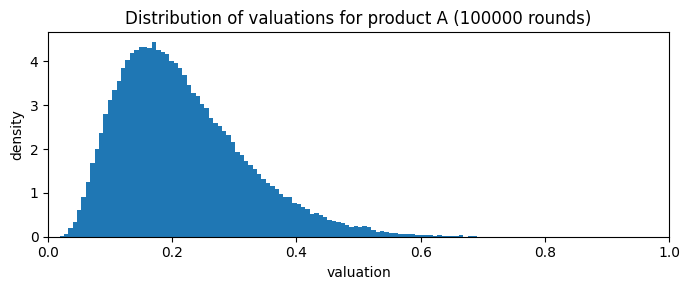

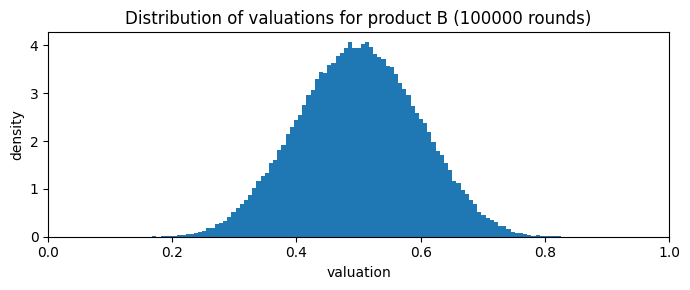

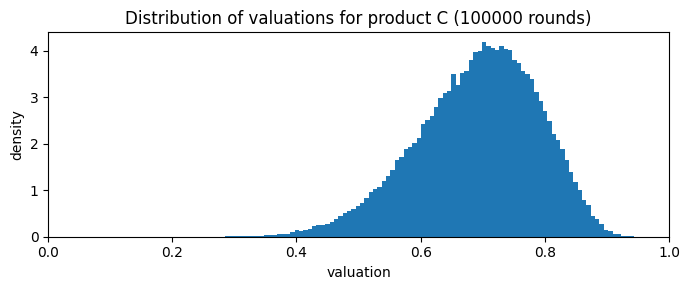

[0.15739234 0.36241737 0.72385043]
[0. 0. 0.] [0 0 0]
[0.30370292 0.59637259 0.67843717]
[0. 0. 0.] [0 0 0]
[0.30351502 0.50922304 0.81238735]
[0.       0.       0.443125] [0 0 1]
[0.24780894 0.47326469 0.59980907]
[0. 0. 0.] [0 0 0]
[0.53345192 0.49082949 0.57182709]
[0.195625 0.       0.01    ] [1 0 1]
[0.25132275 0.63116285 0.65814239]
[0.       0.566875 0.      ] [0 1 0]
[0.11694702 0.60914533 0.74393956]
[0. 0. 0.] [0 0 0]
[0.25286024 0.25170915 0.58932445]
[0.       0.195625 0.      ] [0 1 0]
[0.26019517 0.38469486 0.71059249]
[0.       0.       0.319375] [0 0 1]
[0.0775223  0.46513046 0.67530303]
[0. 0. 0.] [0 0 0]
[0.52012108 0.5822848  0.77285067]
[0.     0.505  0.2575] [0 1 1]
[0.39869071 0.63457432 0.61115413]
[0.    0.    0.505] [0 0 1]
[0.23151568 0.60940335 0.61739915]
[0.     0.2575 0.    ] [0 1 0]
[0.37565434 0.54660974 0.79355346]
[0.195625 0.       0.13375 ] [1 0 1]
[0.15562248 0.63598113 0.44523   ]
[0.       0.       0.195625] [0 0 1]
[0.26081962 0.55401719 0.642955

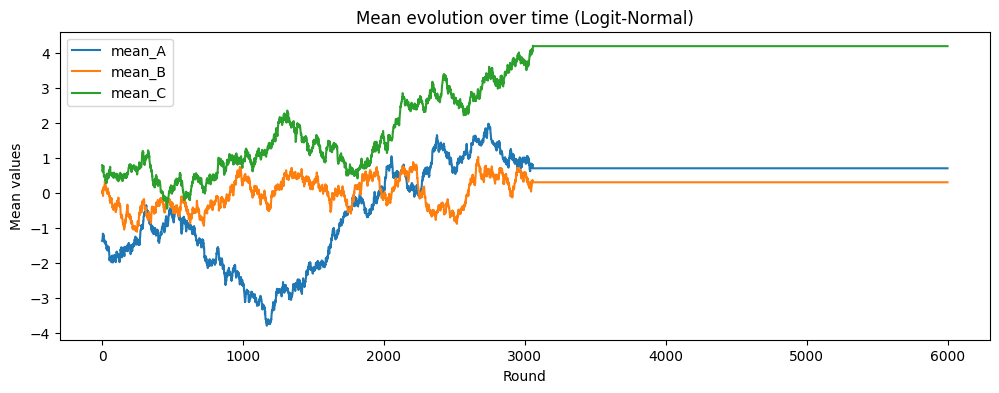

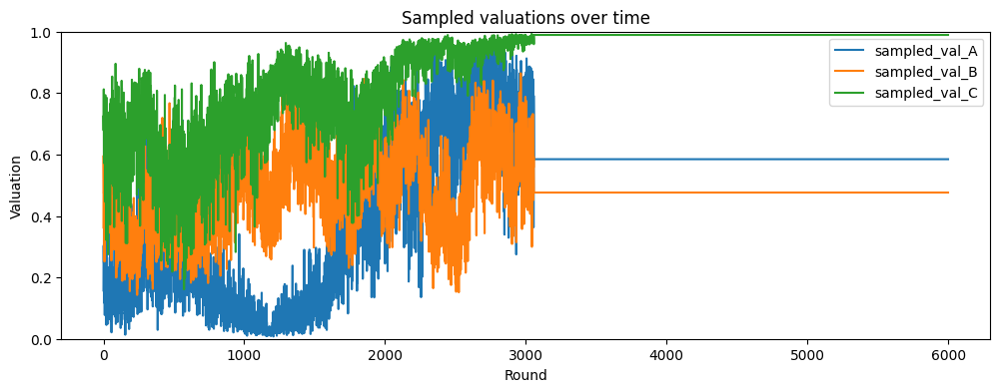

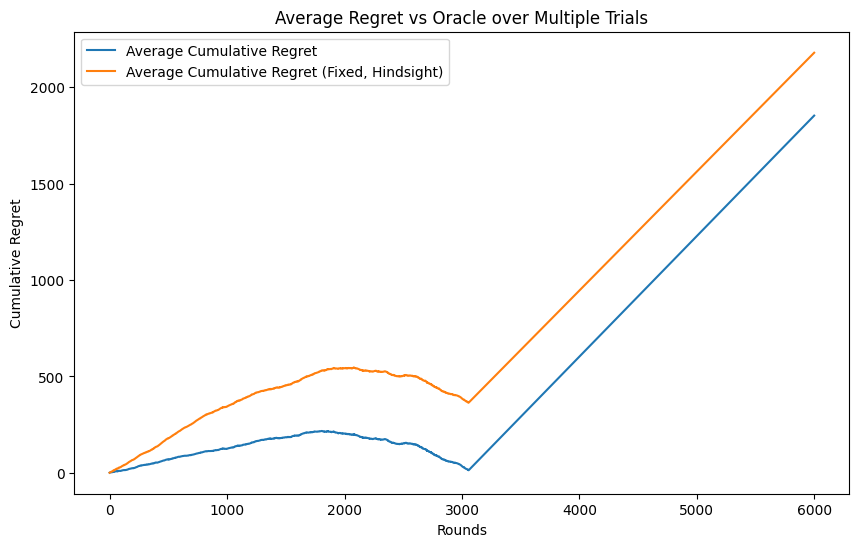

In [21]:
run_one = 1
products = ['A','B','C']
budget = 4000
T = 6000
seeds = [23424,3431,65762,842357,2346532,13564,98765,2557,123564,123567,5783,5380,6942,83129,352,356,684567,264335,5643,8432]

fixed_prices = 0

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)
  #prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_payments, all_regrets_fixed_hind = run_all_trials_parallel(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )
    # Pad regrets to equal length
    #all_regrets = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets])
    avg_regret = all_regrets.mean(axis=0)
    regret_std = all_regrets.std(axis=0)
    #all_regrets_fixed_hind = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets_fixed_hind])
    avg_regret_fixed_hind = all_regrets_fixed_hind.mean(axis=0)
    regret_std_fixed_hind = all_regrets_fixed_hind.std(axis=0)
    avg_payments = np.array(all_payments).mean(axis=0)
    std_payments = np.array(all_payments).std(axis=0)


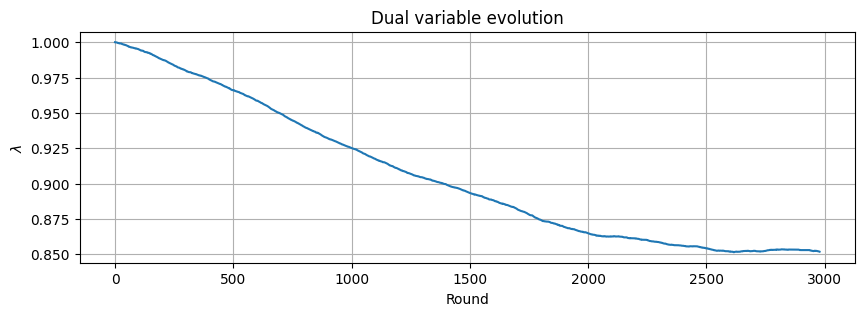

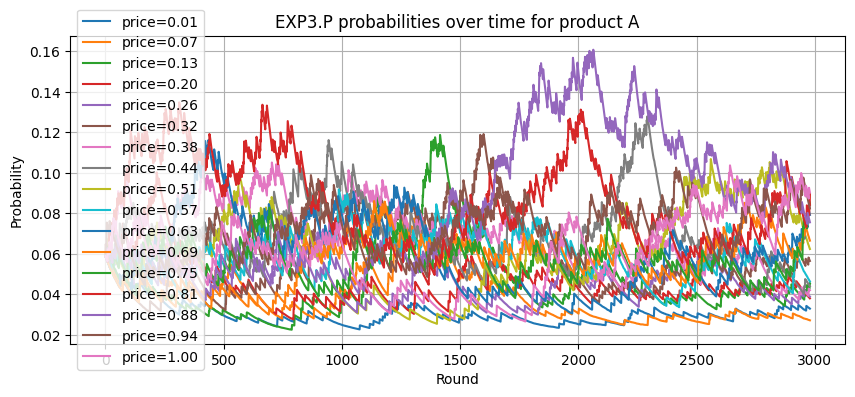

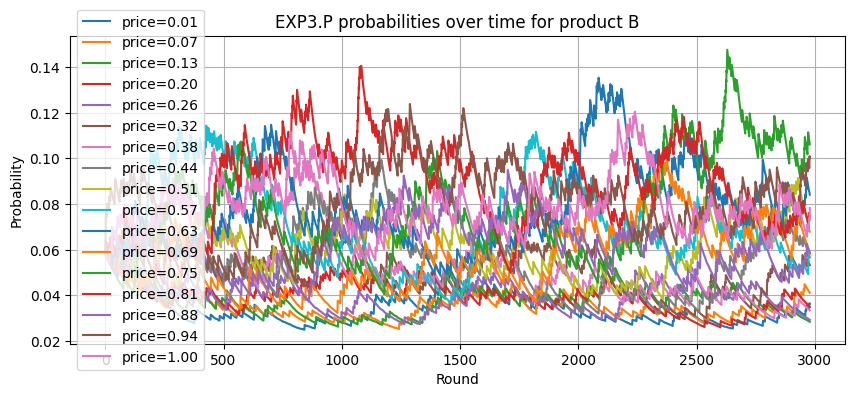

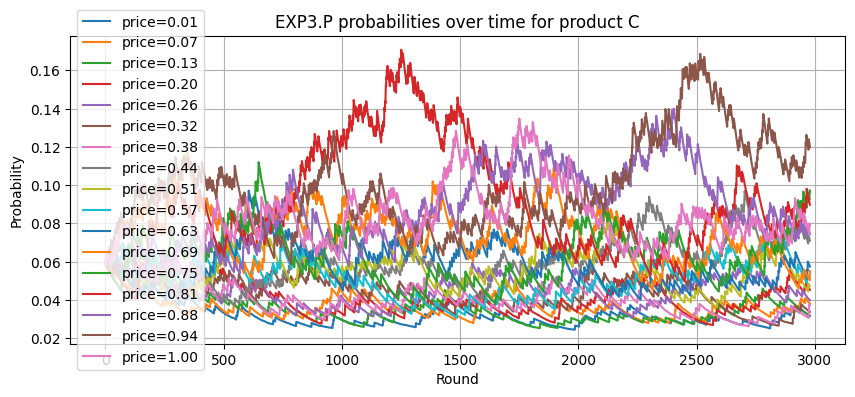

In [13]:
rounds = len(history["lambda"])

# Plot lambda evolution
plt.figure(figsize=(10,3))
plt.plot(range(rounds), history["lambda"], label=r'$\lambda$')
plt.xlabel("Round")
plt.ylabel(r"$\lambda$")
plt.title("Dual variable evolution")
plt.grid(True)
plt.show()

# Plot probabilities per product
for p in products:
    probs_arr = np.array(history["probs"][p])  # shape (rounds, K)
    Kp = probs_arr.shape[1]

    plt.figure(figsize=(10,4))
    for k in range(Kp):
        plt.plot(range(rounds), probs_arr[:, k], label=f'price={prices[p][k]:.2f}')
    plt.xlabel("Round")
    plt.ylabel("Probability")
    plt.title(f"EXP3.P probabilities over time for product {p}")
    plt.legend(loc = 'center left')
    plt.grid(True)
    plt.show()

##### Multiple Trials without horizons

In [ ]:
run_one = 0
products = ['A','B','C']
budget = 4000
T = 6000
seeds = [10123, 47281, 39502, 86734, 19285, 55012, 73190, 28461, 61027, 90834,
         45712, 67209, 31845, 82650, 14029, 59384, 71203, 40917, 28495, 63721]

fixed_prices = 0

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)    
  # prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_payments, all_regrets_fixed_hind = run_all_trials_parallel(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )
    # Pad regrets to equal length
    all_regrets= np.array(all_regrets)
    all_regrets_fixed_hind = np.array(all_regrets_fixed_hind)
    all_payments = np.array(all_payments)
    # all_regrets = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets])
    avg_regret = all_regrets.mean(axis=0)
    regret_std = all_regrets.std(axis=0)
    # all_regrets_fixed_hind = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets_fixed_hind])
    avg_regret_fixed_hind = all_regrets_fixed_hind.mean(axis=0)
    regret_std_fixed_hind = all_regrets_fixed_hind.std(axis=0)
    avg_payments = all_payments.mean(axis=0)
    std_payments = all_payments.std(axis=0)


Discretizing prices with 17 values
[0.01     0.071875 0.13375  0.195625 0.2575   0.319375 0.38125  0.443125
 0.505    0.566875 0.62875  0.690625 0.7525   0.814375 0.87625  0.938125
 1.      ]
{'A': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'B': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'C': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ])}


Trial 1:   0%|          | 0/6000 [00:00<?, ?it/s]



























Trial 1:   0%|          | 1/6000 [00:01<2:18:34,  1.39s/it]




































Trial 1:   0%|          | 9/6000 [00:01<12:59,  7.69it/s]  













Trial 1:   0%|          | 20/6000 [00:01<05:12, 19.13it/s]




















Trial 1:   1%|          | 31/6000 [00:01<03:09, 31.47it/s]

























Trial 1:   1%|          | 44/6000 [00:01<02:06, 46.97it/s]



















Trial 1:   1%|          | 57/6000 [00:01<01:36, 61.28it/s]


















Trial 1:   1%|          | 68/6000 [00:02<01:23, 70.80it/s]





















Trial 1:   1%|▏         | 80/6000 [00:02<01:13, 80.80it/s]


















Trial 1:   2%|▏         | 91/6000 [00:02<01:07, 86.95it/s]




















Trial 1:   2%|▏         | 102/6000 [00:02<01:04, 90.81it/s]




















Trial 1:   2%|▏         | 114/6000 [00:02<01:00, 97.15it/s]




















Trial 1:   2%|▏         | 126/6000 [00:0

<>:17: SyntaxWarning: invalid escape sequence '\s'
<>:17: SyntaxWarning: invalid escape sequence '\s'
C:\Users\digio\AppData\Local\Temp\ipykernel_29312\4011177125.py:17: SyntaxWarning: invalid escape sequence '\s'
  plt.ylabel('$\sum c_t$')


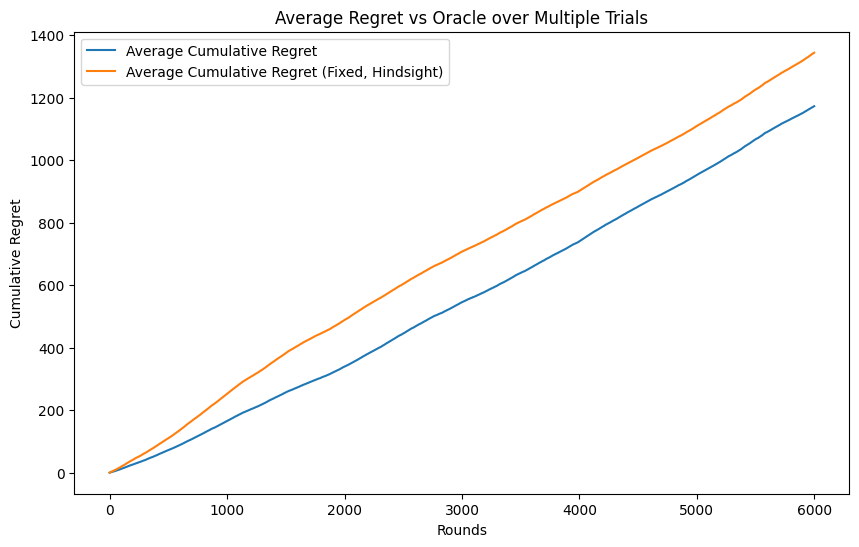

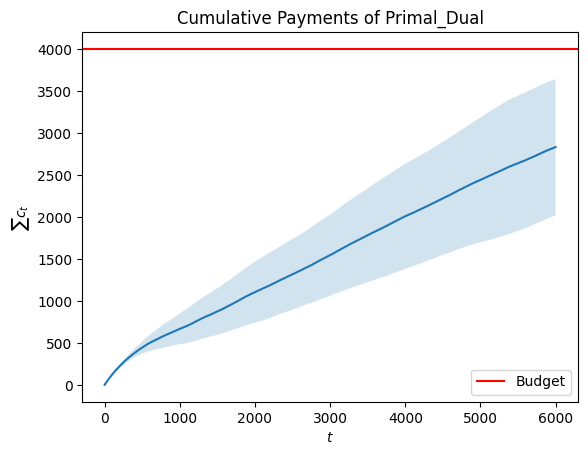

In [71]:
plt.figure(figsize=(10,6))
plt.plot(avg_regret, label='Average Cumulative Regret')
# plt.fill_between(range(T), avg_regret-regret_std, avg_regret+regret_std, alpha=0.2)
# plt.plot(avg_regret_fixed, label='Average Cumulative Regret (Fixed)')
# plt.fill_between(range(T), avg_regret_fixed-regret_std_fixed, avg_regret_fixed+regret_std_fixed, alpha=0.2)
plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
# plt.fill_between(range(T), avg_regret_fixed_hind-regret_std_fixed_hind, avg_regret_fixed_hind+regret_std_fixed_hind, alpha=0.2)
plt.xlabel('Rounds')
plt.ylabel('Cumulative Regret')
plt.title('Average Regret vs Oracle over Multiple Trials')
plt.legend()
plt.show()

plt.plot(np.arange(T), avg_payments)
plt.fill_between(np.arange(T), avg_payments-std_payments, avg_payments+std_payments, alpha=0.2)
plt.xlabel('$t$')
plt.ylabel('$\sum c_t$')
plt.axhline(budget, color='red', label='Budget')
plt.legend()
plt.title('Cumulative Payments of Primal_Dual')
plt.show()

##### Multiple Trials with horizons

In [ ]:
run_one = 0
products = ['A','B','C']
budget = 4000
T = 6000
seeds = [10123, 47281, 39502, 86734, 19285, 55012, 73190, 28461, 61027, 90834,
         45712, 67209, 31845, 82650, 14029, 59384, 71203, 40917, 28495, 63721]

fixed_prices = 0

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)    
  # prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_regrets_fixed_hind, all_payments, horizons,_ = run_all_trials_parallel_horizon(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )

Discretizing prices with 17 values
[0.01     0.071875 0.13375  0.195625 0.2575   0.319375 0.38125  0.443125
 0.505    0.566875 0.62875  0.690625 0.7525   0.814375 0.87625  0.938125
 1.      ]
{'A': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'B': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'C': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ])}


Trial 1:   0%|          | 0/6000 [00:00<?, ?it/s]




















































Trial 1:   0%|          | 1/6000 [00:00<1:02:31,  1.60it/s]




















Trial 1:   0%|          | 4/6000 [00:00<15:04,  6.63it/s]  
















Trial 1:   0%|          | 16/6000 [00:00<03:22, 29.54it/s]




















Trial 1:   0%|          | 30/6000 [00:00<01:51, 53.47it/s]




















Trial 1:   1%|          | 42/6000 [00:01<01:27, 67.95it/s]


















Trial 1:   1%|          | 54/6000 [00:01<01:13, 80.78it/s]




















Trial 1:   1%|          | 65/6000 [00:01<01:19, 74.52it/s]




















Trial 1:   1%|▏         | 75/6000 [00:01<01:57, 50.50it/s]































Trial 1:   2%|▏         | 110/6000 [00:01<01:01, 95.48it/s]

















Trial 1:   2%|▏         | 128/6000 [00:01<00:53, 110.48it/s]







Trial 1:   2%|▏         | 142/6000 [00:02<00:52, 112.30it/s]


















Trial 1:   3%|▎         | 156/6000 

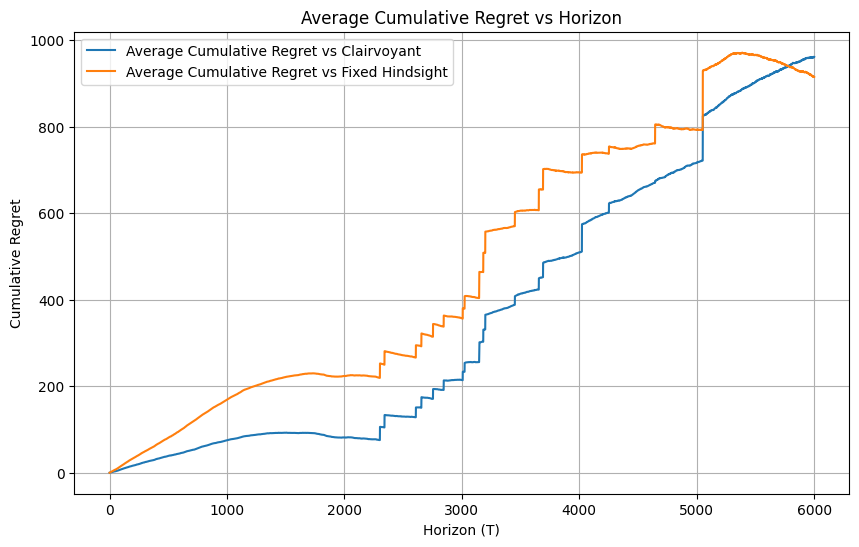

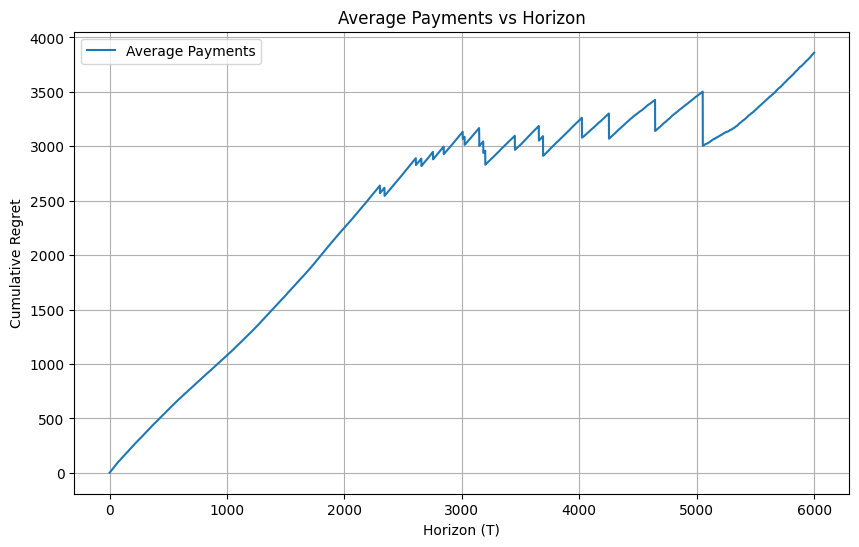

In [ ]:
plot_regret_vs_horizon(all_regrets, all_regrets_fixed_hind, horizons)
plot_payments_vs_horizon(all_payments, horizons, budget)

#### 10 Prices (K = 10)

##### Multiple trials with horizons

In [ ]:
run_one = 0
products = ['A','B','C']
budget = 4000
T = 6000
seeds = [10123, 47281, 39502, 86734, 19285, 55012, 73190, 28461, 61027, 90834,
         45712, 67209, 31845, 82650, 14029, 59384, 71203, 40917, 28495, 63721]

fixed_prices = 1

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)    
  # prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_regrets_fixed_hind, all_payments, horizons,_ = run_all_trials_parallel_horizon(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )

Discretizing prices with 10 values
[0.01 0.12 0.23 0.34 0.45 0.56 0.67 0.78 0.89 1.  ]
{'A': array([0.01, 0.12, 0.23, 0.34, 0.45, 0.56, 0.67, 0.78, 0.89, 1.  ]), 'B': array([0.01, 0.12, 0.23, 0.34, 0.45, 0.56, 0.67, 0.78, 0.89, 1.  ]), 'C': array([0.01, 0.12, 0.23, 0.34, 0.45, 0.56, 0.67, 0.78, 0.89, 1.  ])}


Trial 1:   0%|          | 0/6000 [00:00<?, ?it/s]




















Trial 1:   0%|          | 1/6000 [00:01<2:21:46,  1.42s/it]





Trial 1:   0%|          | 18/6000 [00:01<06:09, 16.18it/s] 





Trial 1:   1%|          | 35/6000 [00:01<02:55, 33.92it/s]





Trial 1:   1%|          | 51/6000 [00:01<01:55, 51.52it/s]











Trial 1:   1%|          | 66/6000 [00:01<01:27, 68.00it/s]














Trial 1:   1%|▏         | 81/6000 [00:01<01:10, 83.47it/s]














Trial 1:   2%|▏         | 96/6000 [00:02<01:06, 89.24it/s]














Trial 1:   2%|▏         | 112/6000 [00:02<00:56, 104.02it/s]














Trial 1:   2%|▏         | 128/6000 [00:02<00:50, 115.92it/s]














Trial 1:   2%|▏         | 143/6000 [00:02<00:47, 122.72it/s]



















Trial 1:   3%|▎         | 161/6000 [00:02<00:43, 132.74it/s]














Trial 1:   3%|▎         | 176/6000 [00:02<00:42, 135.79it/s]

















Trial 1:   3%|▎         | 191/6000 [00:02<00:47, 121.28it/s]





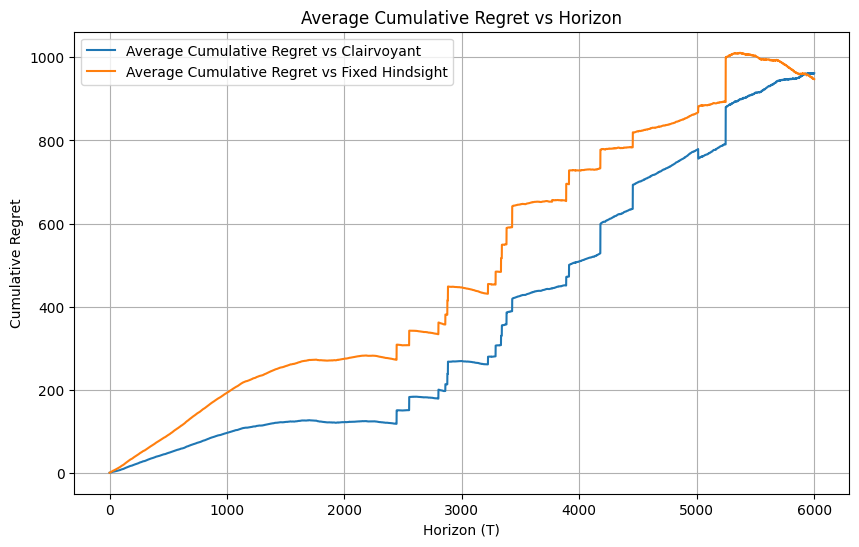

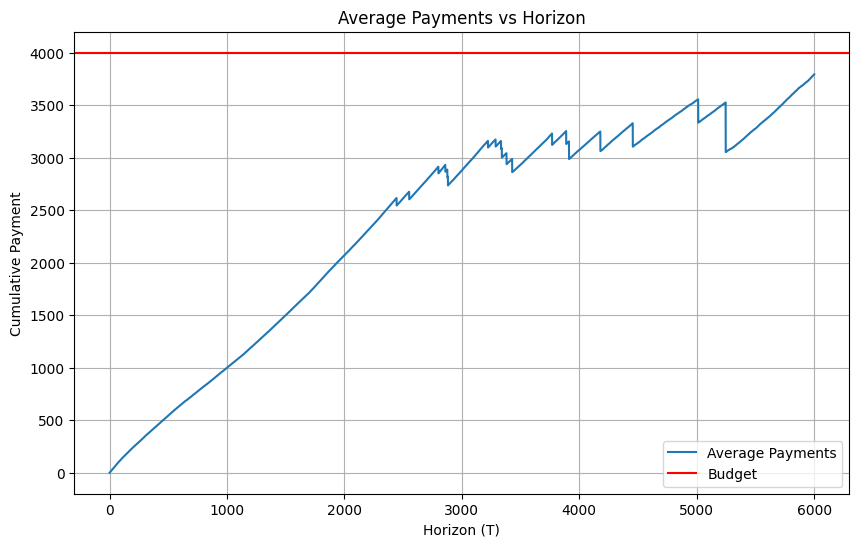

In [25]:
plot_regret_vs_horizon(all_regrets, all_regrets_fixed_hind, horizons)
plot_payments_vs_horizon(all_payments, horizons, budget)

### Trial: B = T

#### Optimal Prices

##### Single Trial for visualization

Discretizing prices with 17 values
[0.01     0.071875 0.13375  0.195625 0.2575   0.319375 0.38125  0.443125
 0.505    0.566875 0.62875  0.690625 0.7525   0.814375 0.87625  0.938125
 1.      ]
{'A': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'B': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'C': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ])}


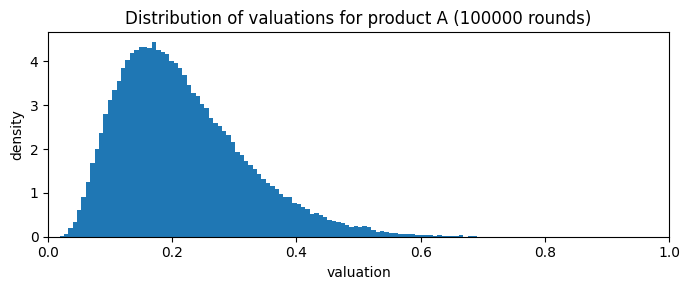

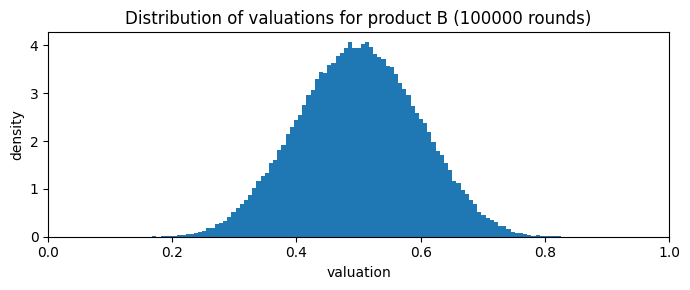

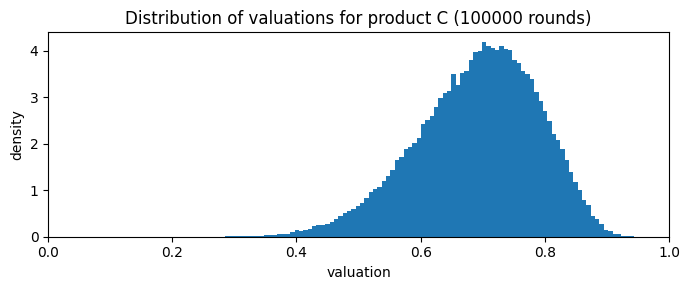

[0.15739234 0.36241737 0.72385043]
[0.01     0.319375 0.071875] [1 1 1]
[0.30370292 0.59637259 0.67843717]
[0.195625 0.       0.505   ] [1 0 1]
[0.30351502 0.50922304 0.81238735]
[0.       0.       0.195625] [0 0 1]
[0.24780894 0.47326469 0.59980907]
[0.       0.       0.195625] [0 0 1]
[0.53345192 0.49082949 0.57182709]
[0.       0.443125 0.443125] [0 1 1]
[0.25132275 0.63116285 0.65814239]
[0.13375  0.195625 0.38125 ] [1 1 1]
[0.11694702 0.60914533 0.74393956]
[0.       0.505    0.195625] [0 1 1]
[0.25286024 0.25170915 0.58932445]
[0. 0. 0.] [0 0 0]
[0.26019517 0.38469486 0.71059249]
[0.       0.       0.071875] [0 0 1]
[0.0775223  0.46513046 0.67530303]
[0.       0.071875 0.      ] [0 1 0]
[0.52012108 0.5822848  0.77285067]
[0.13375 0.      0.62875] [1 0 1]
[0.39869071 0.63457432 0.61115413]
[0.38125 0.      0.     ] [1 0 0]
[0.23151568 0.60940335 0.61739915]
[0.01  0.505 0.   ] [1 1 0]
[0.37565434 0.54660974 0.79355346]
[0.195625 0.       0.62875 ] [1 0 1]
[0.15562248 0.63598113 0.

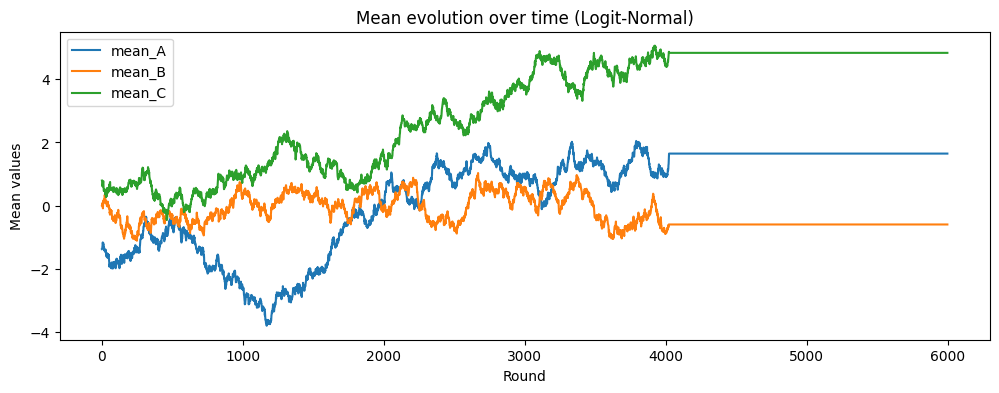

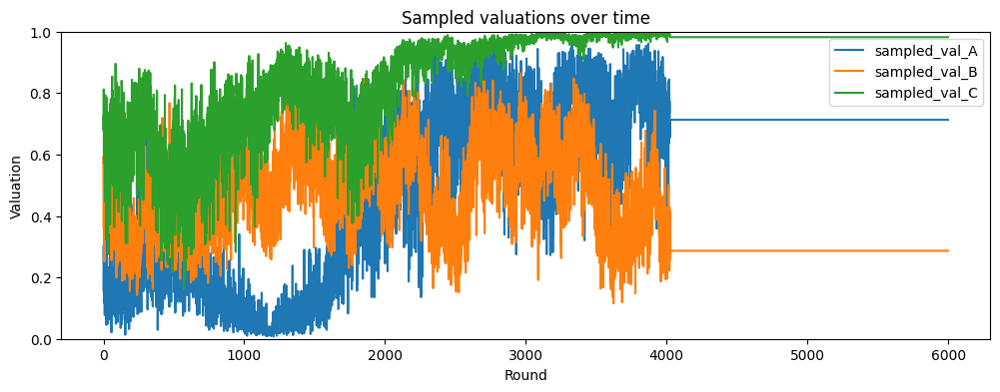

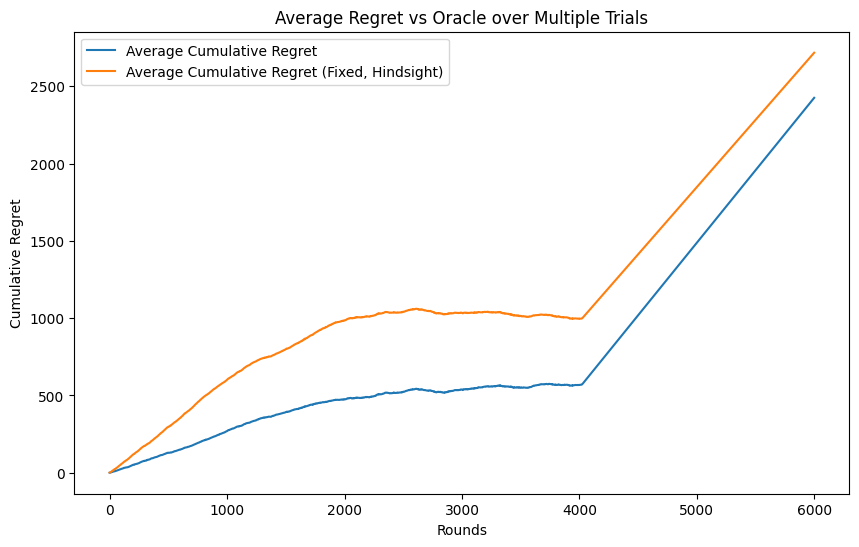

In [ ]:
run_one = 1
products = ['A','B','C']
budget = 6000
T = 6000
seeds = [23424,3431,65762,842357,2346532,13564,98765,2557,123564,123567,5783,5380,6942,83129,352,356,684567,264335,5643,8432]

fixed_prices = 0

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)
  #prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_payments, all_regrets_fixed_hind = run_all_trials_parallel(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )
    # Pad regrets to equal length
    #all_regrets = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets])
    avg_regret = all_regrets.mean(axis=0)
    regret_std = all_regrets.std(axis=0)
    #all_regrets_fixed_hind = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets_fixed_hind])
    avg_regret_fixed_hind = all_regrets_fixed_hind.mean(axis=0)
    regret_std_fixed_hind = all_regrets_fixed_hind.std(axis=0)
    avg_payments = np.array(all_payments).mean(axis=0)
    std_payments = np.array(all_payments).std(axis=0)


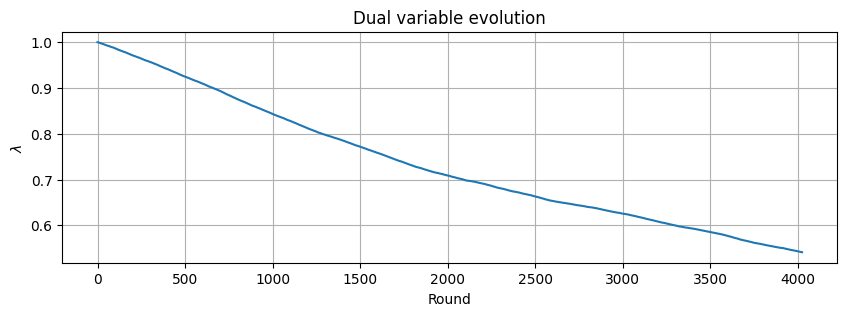

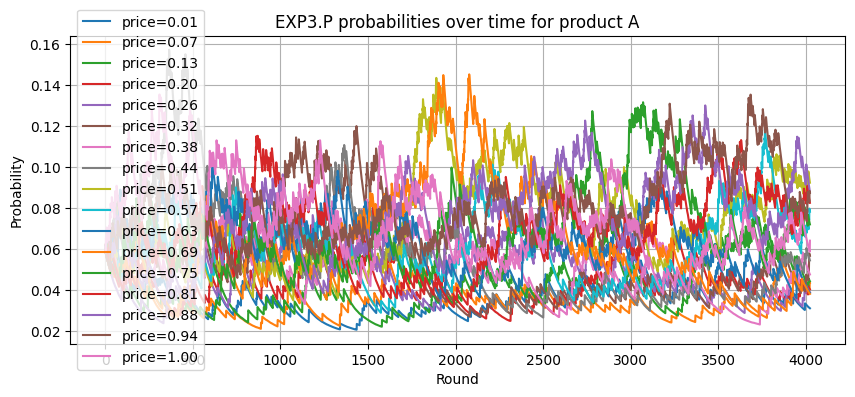

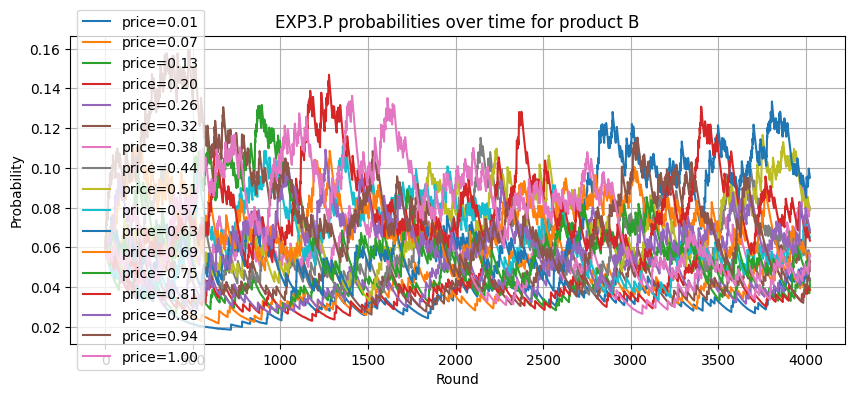

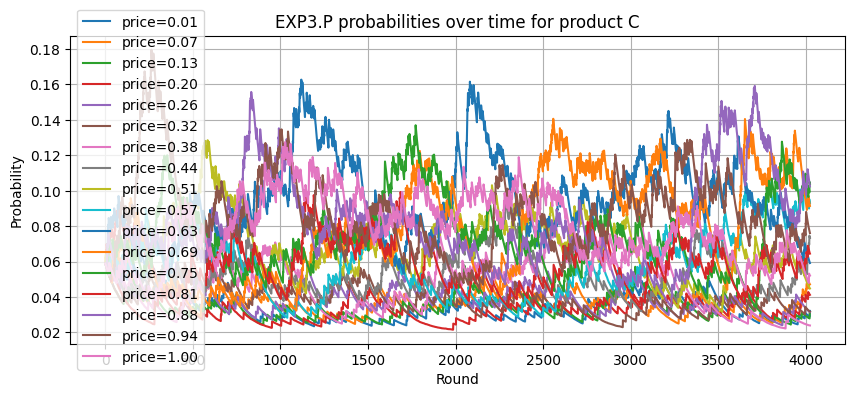

In [27]:
rounds = len(history["lambda"])

# Plot lambda evolution
plt.figure(figsize=(10,3))
plt.plot(range(rounds), history["lambda"], label=r'$\lambda$')
plt.xlabel("Round")
plt.ylabel(r"$\lambda$")
plt.title("Dual variable evolution")
plt.grid(True)
plt.show()

# Plot probabilities per product
for p in products:
    probs_arr = np.array(history["probs"][p])  # shape (rounds, K)
    Kp = probs_arr.shape[1]

    plt.figure(figsize=(10,4))
    for k in range(Kp):
        plt.plot(range(rounds), probs_arr[:, k], label=f'price={prices[p][k]:.2f}')
    plt.xlabel("Round")
    plt.ylabel("Probability")
    plt.title(f"EXP3.P probabilities over time for product {p}")
    plt.legend(loc = 'center left')
    plt.grid(True)
    plt.show()

##### Multiple Trials without horizons

In [ ]:
run_one = 0
products = ['A','B','C']
budget = 6000
T = 6000
seeds = [10123, 47281, 39502, 86734, 19285, 55012, 73190, 28461, 61027, 90834,
         45712, 67209, 31845, 82650, 14029, 59384, 71203, 40917, 28495, 63721]

fixed_prices = 0

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)    
  # prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_payments, all_regrets_fixed_hind = run_all_trials_parallel(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )
    # Pad regrets to equal length
    all_regrets= np.array(all_regrets)
    all_regrets_fixed_hind = np.array(all_regrets_fixed_hind)
    all_payments = np.array(all_payments)
    # all_regrets = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets])
    avg_regret = all_regrets.mean(axis=0)
    regret_std = all_regrets.std(axis=0)
    # all_regrets_fixed_hind = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets_fixed_hind])
    avg_regret_fixed_hind = all_regrets_fixed_hind.mean(axis=0)
    regret_std_fixed_hind = all_regrets_fixed_hind.std(axis=0)
    avg_payments = all_payments.mean(axis=0)
    std_payments = all_payments.std(axis=0)


Discretizing prices with 17 values
[0.01     0.071875 0.13375  0.195625 0.2575   0.319375 0.38125  0.443125
 0.505    0.566875 0.62875  0.690625 0.7525   0.814375 0.87625  0.938125
 1.      ]
{'A': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'B': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'C': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ])}


Trial 1:   0%|          | 0/6000 [00:00<?, ?it/s]




















Trial 1:   0%|          | 1/6000 [00:00<43:04,  2.32it/s]




Trial 1:   0%|          | 14/6000 [00:00<02:56, 33.88it/s]








Trial 1:   0%|          | 27/6000 [00:00<01:43, 57.67it/s]
















Trial 1:   1%|          | 38/6000 [00:00<01:23, 71.49it/s]




















Trial 1:   1%|          | 50/6000 [00:00<01:10, 84.11it/s]




















Trial 1:   1%|          | 61/6000 [00:00<01:05, 91.08it/s]




















Trial 1:   1%|          | 73/6000 [00:01<01:00, 98.13it/s]




















Trial 1:   1%|▏         | 84/6000 [00:01<00:58, 100.30it/s]




















Trial 1:   2%|▏         | 95/6000 [00:01<01:00, 97.27it/s] 




















Trial 1:   2%|▏         | 107/6000 [00:01<00:57, 102.75it/s]




















Trial 1:   2%|▏         | 119/6000 [00:01<00:55, 106.86it/s]





























Trial 1:   2%|▏         | 131/6000 [00:01<01:01, 95.53it/s] 




















<>:17: SyntaxWarning: invalid escape sequence '\s'
<>:17: SyntaxWarning: invalid escape sequence '\s'
C:\Users\digio\AppData\Local\Temp\ipykernel_35904\4011177125.py:17: SyntaxWarning: invalid escape sequence '\s'
  plt.ylabel('$\sum c_t$')


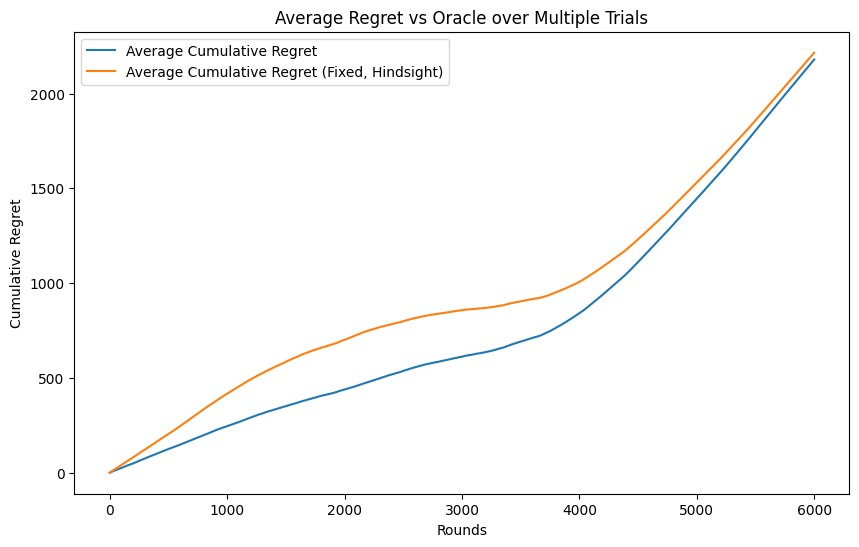

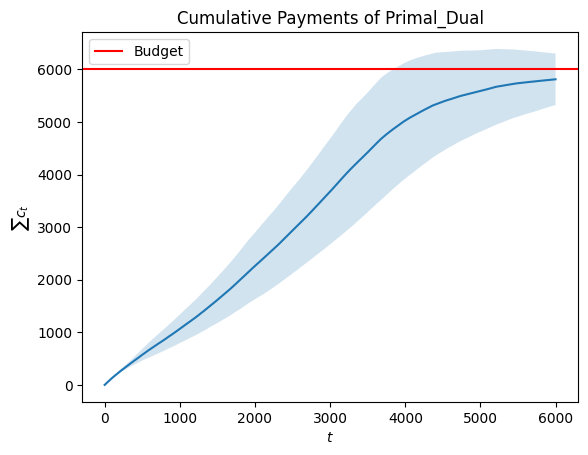

In [29]:
plt.figure(figsize=(10,6))
plt.plot(avg_regret, label='Average Cumulative Regret')
# plt.fill_between(range(T), avg_regret-regret_std, avg_regret+regret_std, alpha=0.2)
# plt.plot(avg_regret_fixed, label='Average Cumulative Regret (Fixed)')
# plt.fill_between(range(T), avg_regret_fixed-regret_std_fixed, avg_regret_fixed+regret_std_fixed, alpha=0.2)
plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
# plt.fill_between(range(T), avg_regret_fixed_hind-regret_std_fixed_hind, avg_regret_fixed_hind+regret_std_fixed_hind, alpha=0.2)
plt.xlabel('Rounds')
plt.ylabel('Cumulative Regret')
plt.title('Average Regret vs Oracle over Multiple Trials')
plt.legend()
plt.show()

plt.plot(np.arange(T), avg_payments)
plt.fill_between(np.arange(T), avg_payments-std_payments, avg_payments+std_payments, alpha=0.2)
plt.xlabel('$t$')
plt.ylabel('$\sum c_t$')
plt.axhline(budget, color='red', label='Budget')
plt.legend()
plt.title('Cumulative Payments of Primal_Dual')
plt.show()

##### Multiple trials with horizons

In [ ]:
run_one = 0
products = ['A','B','C']
budget = 6000
T = 6000
seeds = [10123, 47281, 39502, 86734, 19285, 55012, 73190, 28461, 61027, 90834,
         45712, 67209, 31845, 82650, 14029, 59384, 71203, 40917, 28495, 63721]

fixed_prices = 0

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)    
  # prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_regrets_fixed_hind, all_payments, horizons,_ = run_all_trials_parallel_horizon(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )

Discretizing prices with 17 values
[0.01     0.071875 0.13375  0.195625 0.2575   0.319375 0.38125  0.443125
 0.505    0.566875 0.62875  0.690625 0.7525   0.814375 0.87625  0.938125
 1.      ]
{'A': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'B': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'C': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ])}


Trial 1:   0%|          | 0/6000 [00:00<?, ?it/s]























Trial 1:   0%|          | 1/6000 [00:00<50:50,  1.97it/s]








Trial 1:   0%|          | 12/6000 [00:00<03:58, 25.08it/s]
















Trial 1:   0%|          | 24/6000 [00:00<02:06, 47.08it/s]




















Trial 1:   1%|          | 37/6000 [00:00<01:29, 66.40it/s]




















Trial 1:   1%|          | 50/6000 [00:00<01:12, 82.20it/s]




















Trial 1:   1%|          | 61/6000 [00:01<01:07, 88.18it/s]




















Trial 1:   1%|          | 72/6000 [00:01<01:06, 89.31it/s]























Trial 1:   1%|▏         | 83/6000 [00:01<01:05, 89.74it/s]




















Trial 1:   2%|▏         | 93/6000 [00:01<01:19, 73.92it/s]




















Trial 1:   2%|▏         | 113/6000 [00:01<00:57, 101.92it/s]




















Trial 1:   2%|▏         | 125/6000 [00:01<00:56, 103.14it/s]




















Trial 1:   2%|▏         | 137/6000 [00:01<01:00, 96.94it/s] 









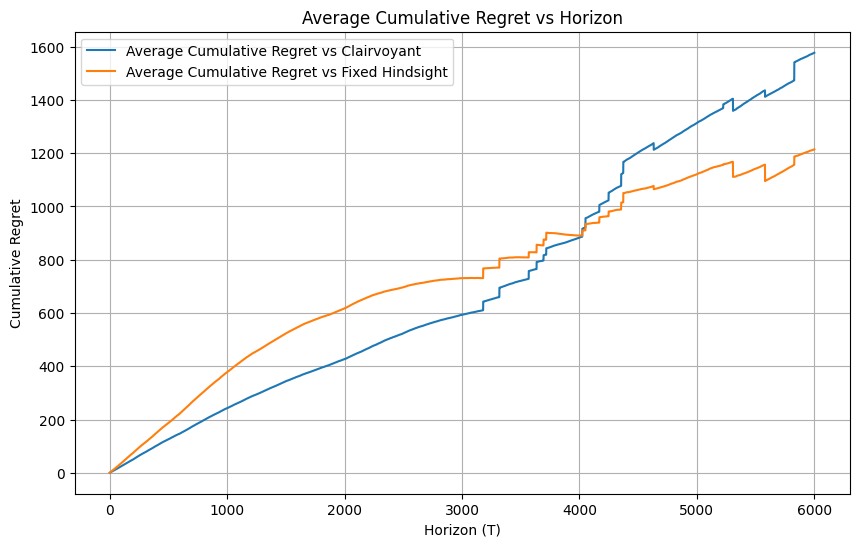

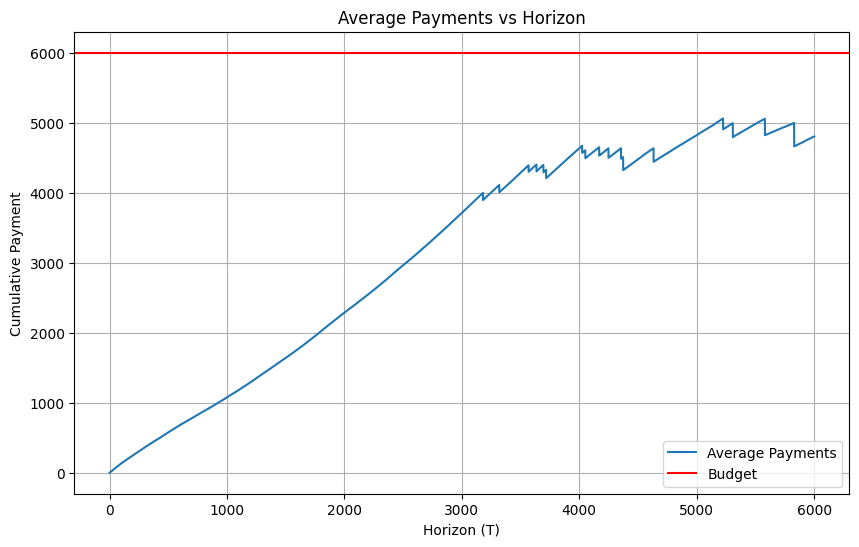

In [31]:
plot_regret_vs_horizon(all_regrets, all_regrets_fixed_hind, horizons)
plot_payments_vs_horizon(all_payments, horizons, budget)

#### 10 Prices (K = 10)

##### Multiple trials with horizons

In [ ]:
run_one = 0
products = ['A','B','C']
budget = 6000
T = 6000
seeds = [10123, 47281, 39502, 86734, 19285, 55012, 73190, 28461, 61027, 90834,
         45712, 67209, 31845, 82650, 14029, 59384, 71203, 40917, 28495, 63721]

fixed_prices = 1

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)    
  # prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_regrets_fixed_hind, all_payments, horizons,_ = run_all_trials_parallel_horizon(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )

Discretizing prices with 10 values
[0.01 0.12 0.23 0.34 0.45 0.56 0.67 0.78 0.89 1.  ]
{'A': array([0.01, 0.12, 0.23, 0.34, 0.45, 0.56, 0.67, 0.78, 0.89, 1.  ]), 'B': array([0.01, 0.12, 0.23, 0.34, 0.45, 0.56, 0.67, 0.78, 0.89, 1.  ]), 'C': array([0.01, 0.12, 0.23, 0.34, 0.45, 0.56, 0.67, 0.78, 0.89, 1.  ])}


Trial 1:   0%|          | 0/6000 [00:00<?, ?it/s]





























Trial 1:   0%|          | 1/6000 [00:00<59:16,  1.69it/s]













Trial 1:   0%|          | 17/6000 [00:00<03:05, 32.27it/s]













Trial 1:   1%|          | 34/6000 [00:00<01:36, 61.61it/s]



















Trial 1:   1%|          | 51/6000 [00:00<01:08, 86.69it/s]



















Trial 1:   1%|          | 67/6000 [00:01<00:56, 104.13it/s]




















Trial 1:   1%|▏         | 84/6000 [00:01<00:48, 121.01it/s]




















Trial 1:   2%|▏         | 100/6000 [00:01<00:46, 125.98it/s]




















Trial 1:   2%|▏         | 117/6000 [00:01<00:42, 137.77it/s]




















Trial 1:   2%|▏         | 134/6000 [00:01<00:40, 145.80it/s]




















Trial 1:   2%|▎         | 150/6000 [00:01<00:39, 149.47it/s]




















Trial 1:   3%|▎         | 167/6000 [00:01<00:37, 154.83it/s]

















Trial 1:   3%|▎         | 185/6000 [00:01<00:36, 158.56it/s]

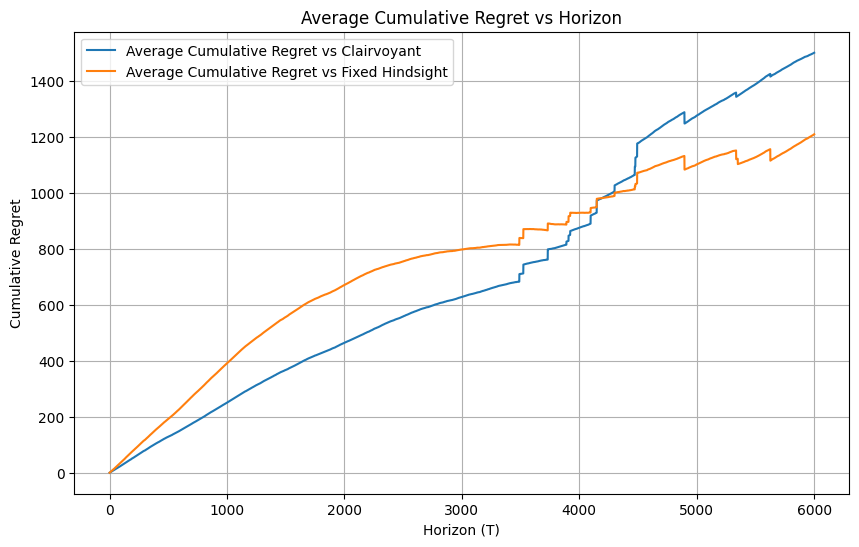

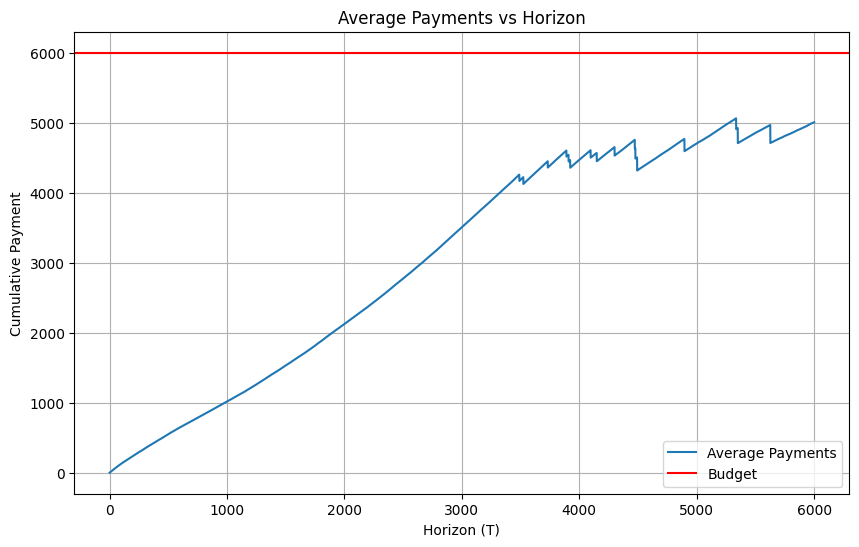

In [33]:
plot_regret_vs_horizon(all_regrets, all_regrets_fixed_hind, horizons)
plot_payments_vs_horizon(all_payments, horizons, budget)

### Trial: B > T

#### Optimal prices

##### Single Trial for visualization

Discretizing prices with 17 values
[0.01     0.071875 0.13375  0.195625 0.2575   0.319375 0.38125  0.443125
 0.505    0.566875 0.62875  0.690625 0.7525   0.814375 0.87625  0.938125
 1.      ]
{'A': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'B': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'C': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ])}


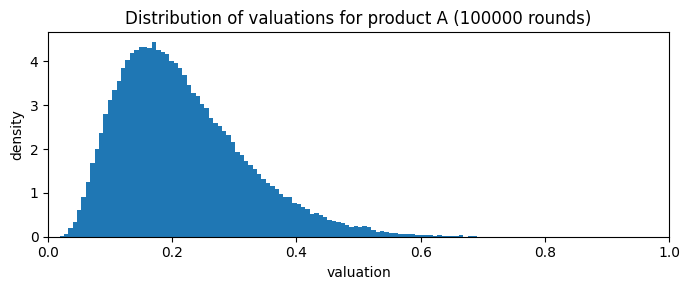

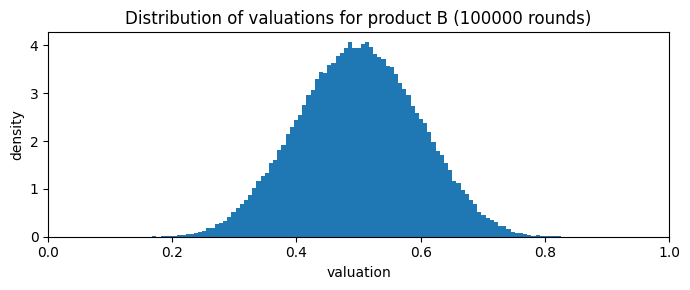

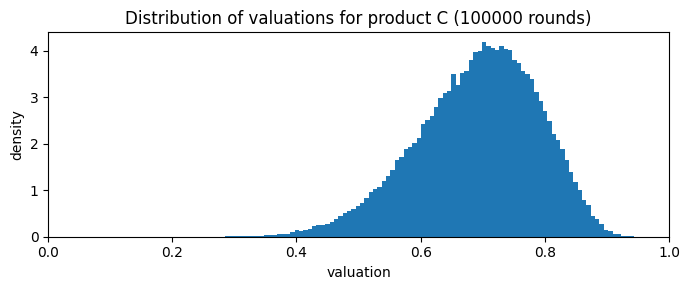

[0.15739234 0.36241737 0.72385043]
[0.       0.       0.443125] [0 0 1]
[0.30370292 0.59637259 0.67843717]
[0.13375 0.      0.01   ] [1 0 1]
[0.30351502 0.50922304 0.81238735]
[0.      0.      0.38125] [0 0 1]
[0.24780894 0.47326469 0.59980907]
[0. 0. 0.] [0 0 0]
[0.53345192 0.49082949 0.57182709]
[0.319375 0.       0.      ] [1 0 0]
[0.25132275 0.63116285 0.65814239]
[0.      0.      0.62875] [0 0 1]
[0.11694702 0.60914533 0.74393956]
[0.       0.443125 0.13375 ] [0 1 1]
[0.25286024 0.25170915 0.58932445]
[0.       0.       0.566875] [0 0 1]
[0.26019517 0.38469486 0.71059249]
[0.       0.071875 0.      ] [0 1 0]
[0.0775223  0.46513046 0.67530303]
[0.    0.    0.505] [0 0 1]
[0.52012108 0.5822848  0.77285067]
[0.13375 0.      0.     ] [1 0 0]
[0.39869071 0.63457432 0.61115413]
[0.       0.566875 0.13375 ] [0 1 1]
[0.23151568 0.60940335 0.61739915]
[0.    0.    0.505] [0 0 1]
[0.37565434 0.54660974 0.79355346]
[0.13375  0.01     0.566875] [1 1 1]
[0.15562248 0.63598113 0.44523   ]
[0.01

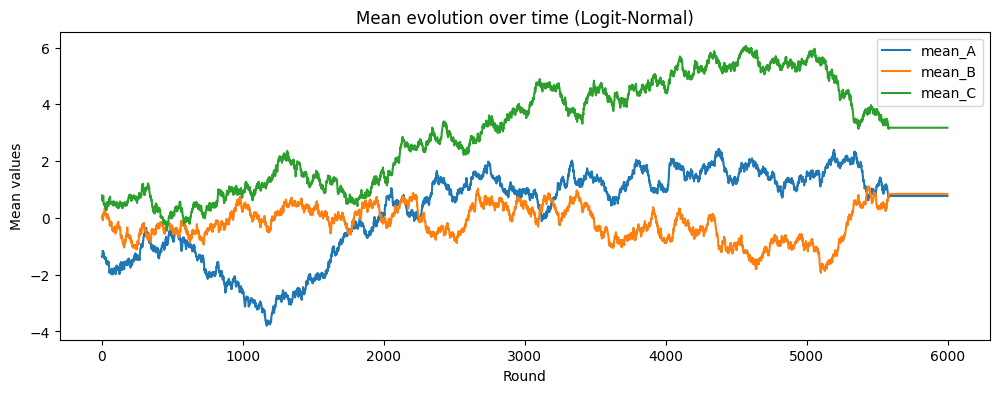

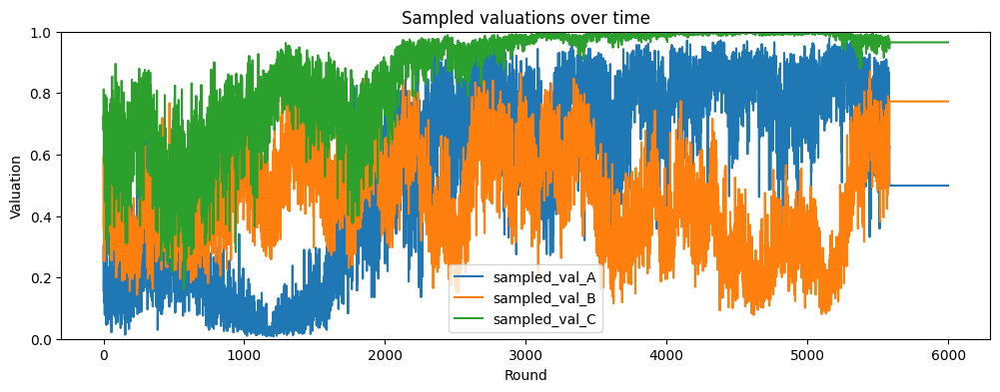

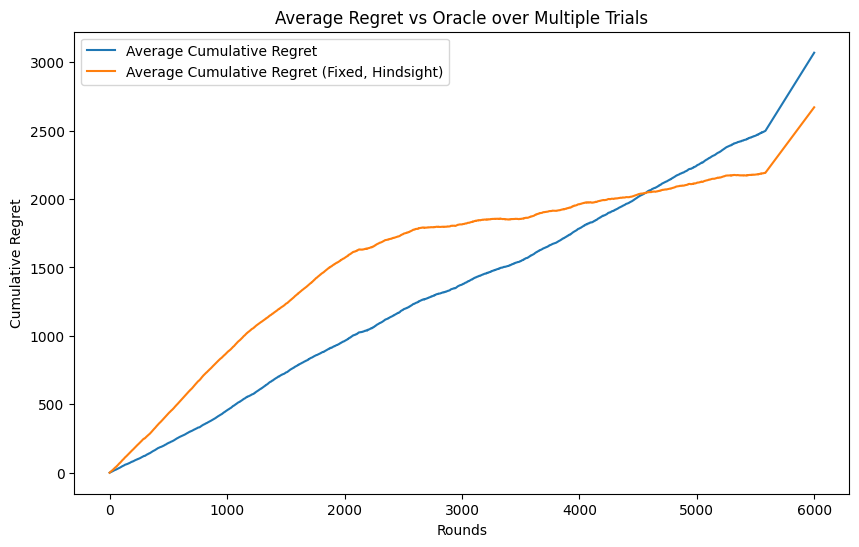

In [ ]:
run_one = 1
products = ['A','B','C']
budget = 10000
T = 6000
seeds = [23424,3431,65762,842357,2346532,13564,98765,2557,123564,123567,5783,5380,6942,83129,352,356,684567,264335,5643,8432]

fixed_prices = 0

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)
  #prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_payments, all_regrets_fixed_hind = run_all_trials_parallel(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )
    # Pad regrets to equal length
    #all_regrets = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets])
    avg_regret = all_regrets.mean(axis=0)
    regret_std = all_regrets.std(axis=0)
    #all_regrets_fixed_hind = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets_fixed_hind])
    avg_regret_fixed_hind = all_regrets_fixed_hind.mean(axis=0)
    regret_std_fixed_hind = all_regrets_fixed_hind.std(axis=0)
    avg_payments = np.array(all_payments).mean(axis=0)
    std_payments = np.array(all_payments).std(axis=0)


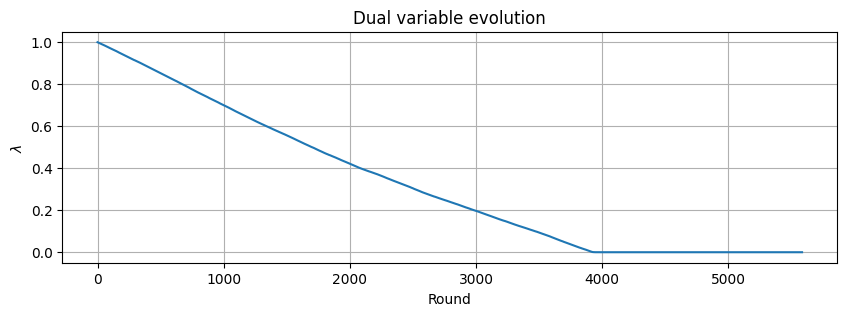

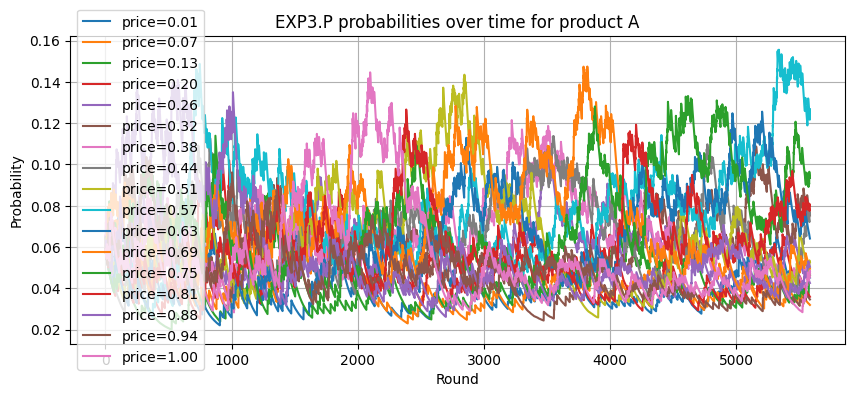

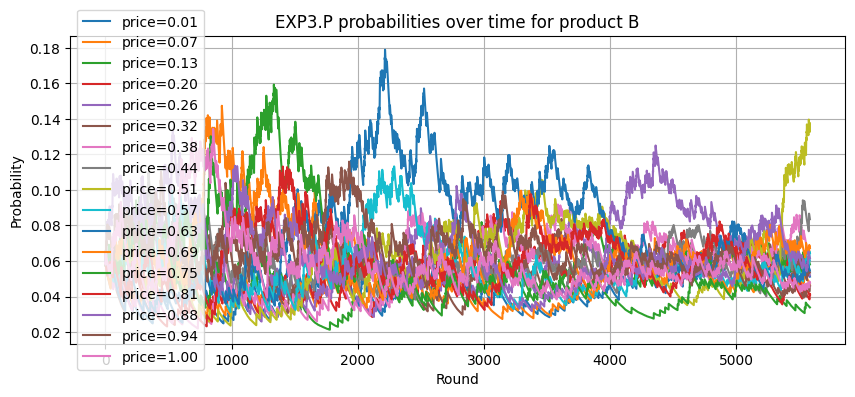

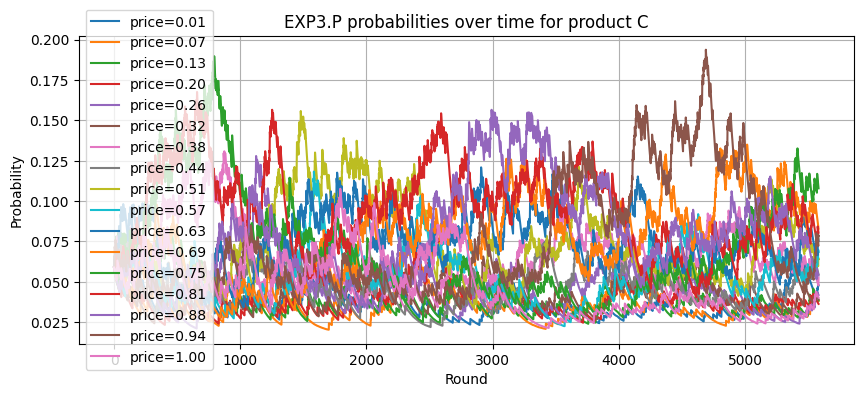

In [35]:
rounds = len(history["lambda"])

# Plot lambda evolution
plt.figure(figsize=(10,3))
plt.plot(range(rounds), history["lambda"], label=r'$\lambda$')
plt.xlabel("Round")
plt.ylabel(r"$\lambda$")
plt.title("Dual variable evolution")
plt.grid(True)
plt.show()

# Plot probabilities per product
for p in products:
    probs_arr = np.array(history["probs"][p])  # shape (rounds, K)
    Kp = probs_arr.shape[1]

    plt.figure(figsize=(10,4))
    for k in range(Kp):
        plt.plot(range(rounds), probs_arr[:, k], label=f'price={prices[p][k]:.2f}')
    plt.xlabel("Round")
    plt.ylabel("Probability")
    plt.title(f"EXP3.P probabilities over time for product {p}")
    plt.legend(loc = 'center left')
    plt.grid(True)
    plt.show()

##### Multiple Trials without horizons

In [ ]:
run_one = 0
products = ['A','B','C']
budget = 10000
T = 6000
seeds = [10123, 47281, 39502, 86734, 19285, 55012, 73190, 28461, 61027, 90834,
         45712, 67209, 31845, 82650, 14029, 59384, 71203, 40917, 28495, 63721]

fixed_prices = 0

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)    
  # prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_payments, all_regrets_fixed_hind = run_all_trials_parallel(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )
    # Pad regrets to equal length
    all_regrets= np.array(all_regrets)
    all_regrets_fixed_hind = np.array(all_regrets_fixed_hind)
    all_payments = np.array(all_payments)
    # all_regrets = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets])
    avg_regret = all_regrets.mean(axis=0)
    regret_std = all_regrets.std(axis=0)
    # all_regrets_fixed_hind = np.array([np.pad(r[:T], (0, T - len(r[:T])), 'edge') for r in all_regrets_fixed_hind])
    avg_regret_fixed_hind = all_regrets_fixed_hind.mean(axis=0)
    regret_std_fixed_hind = all_regrets_fixed_hind.std(axis=0)
    avg_payments = all_payments.mean(axis=0)
    std_payments = all_payments.std(axis=0)


Discretizing prices with 17 values
[0.01     0.071875 0.13375  0.195625 0.2575   0.319375 0.38125  0.443125
 0.505    0.566875 0.62875  0.690625 0.7525   0.814375 0.87625  0.938125
 1.      ]
{'A': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'B': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'C': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ])}


Trial 1:   0%|          | 0/6000 [00:00<?, ?it/s]




















Trial 1:   0%|          | 1/6000 [00:00<42:51,  2.33it/s]




Trial 1:   0%|          | 15/6000 [00:00<02:45, 36.17it/s]










Trial 1:   0%|          | 27/6000 [00:00<01:43, 57.58it/s]














Trial 1:   1%|          | 40/6000 [00:00<01:17, 77.07it/s]














Trial 1:   1%|          | 52/6000 [00:00<01:07, 88.16it/s]














Trial 1:   1%|          | 65/6000 [00:00<00:59, 99.18it/s]




















Trial 1:   1%|▏         | 78/6000 [00:01<00:56, 105.38it/s]




















Trial 1:   2%|▏         | 90/6000 [00:01<00:54, 108.24it/s]



















Trial 1:   2%|▏         | 103/6000 [00:01<00:53, 109.57it/s]



















































































Trial 1:   2%|▏         | 115/6000 [00:01<01:41, 57.77it/s] 




















Trial 1:   2%|▏         | 127/6000 [00:01<01:26, 67.82it/s]




















Trial 1:   2%|▏         | 140/6000 [0

<>:17: SyntaxWarning: invalid escape sequence '\s'
<>:17: SyntaxWarning: invalid escape sequence '\s'
C:\Users\digio\AppData\Local\Temp\ipykernel_35904\4011177125.py:17: SyntaxWarning: invalid escape sequence '\s'
  plt.ylabel('$\sum c_t$')


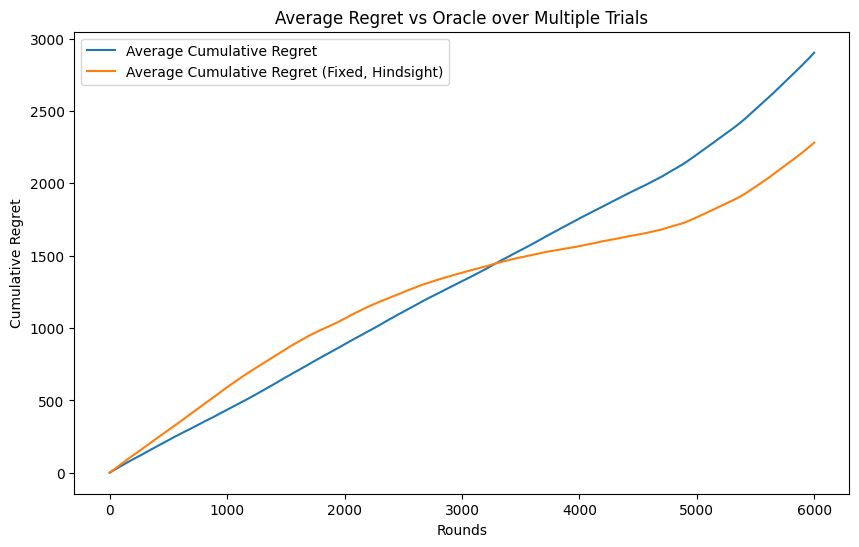

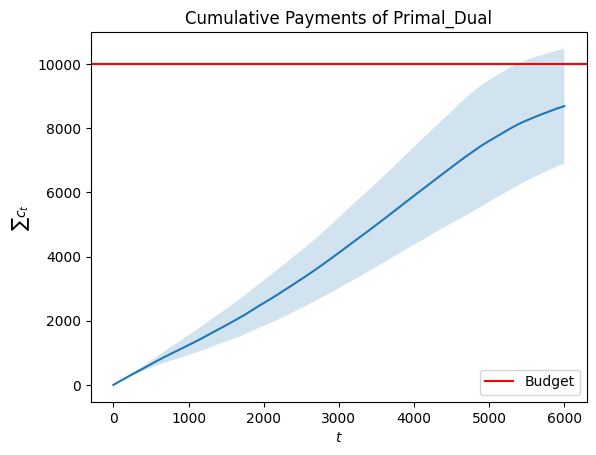

In [37]:
plt.figure(figsize=(10,6))
plt.plot(avg_regret, label='Average Cumulative Regret')
# plt.fill_between(range(T), avg_regret-regret_std, avg_regret+regret_std, alpha=0.2)
# plt.plot(avg_regret_fixed, label='Average Cumulative Regret (Fixed)')
# plt.fill_between(range(T), avg_regret_fixed-regret_std_fixed, avg_regret_fixed+regret_std_fixed, alpha=0.2)
plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
# plt.fill_between(range(T), avg_regret_fixed_hind-regret_std_fixed_hind, avg_regret_fixed_hind+regret_std_fixed_hind, alpha=0.2)
plt.xlabel('Rounds')
plt.ylabel('Cumulative Regret')
plt.title('Average Regret vs Oracle over Multiple Trials')
plt.legend()
plt.show()

plt.plot(np.arange(T), avg_payments)
plt.fill_between(np.arange(T), avg_payments-std_payments, avg_payments+std_payments, alpha=0.2)
plt.xlabel('$t$')
plt.ylabel('$\sum c_t$')
plt.axhline(budget, color='red', label='Budget')
plt.legend()
plt.title('Cumulative Payments of Primal_Dual')
plt.show()

##### Multiple trials with horizons

In [ ]:
run_one = 0
products = ['A','B','C']
budget = 10000
T = 6000
seeds = [10123, 47281, 39502, 86734, 19285, 55012, 73190, 28461, 61027, 90834,
         45712, 67209, 31845, 82650, 14029, 59384, 71203, 40917, 28495, 63721]

fixed_prices = 0

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)    
  # prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_regrets_fixed_hind, all_payments, horizons,_ = run_all_trials_parallel_horizon(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )

Discretizing prices with 17 values
[0.01     0.071875 0.13375  0.195625 0.2575   0.319375 0.38125  0.443125
 0.505    0.566875 0.62875  0.690625 0.7525   0.814375 0.87625  0.938125
 1.      ]
{'A': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'B': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ]), 'C': array([0.01    , 0.071875, 0.13375 , 0.195625, 0.2575  , 0.319375,
       0.38125 , 0.443125, 0.505   , 0.566875, 0.62875 , 0.690625,
       0.7525  , 0.814375, 0.87625 , 0.938125, 1.      ])}


Trial 1:   0%|          | 0/6000 [00:00<?, ?it/s]


Trial 1:   0%|          | 15/6000 [00:00<02:58, 33.60it/s]

Trial 1:   0%|          | 29/6000 [00:00<01:40, 59.24it/s]



Trial 1:   1%|          | 42/6000 [00:00<01:18, 75.93it/s]

Trial 1:   1%|          | 56/6000 [00:00<01:04, 92.78it/s]


Trial 1:   1%|          | 70/6000 [00:00<00:56, 104.56it/s]


Trial 1:   1%|▏         | 84/6000 [00:01<00:52, 112.78it/s]


Trial 1:   2%|▏         | 98/6000 [00:01<00:49, 118.86it/s]




Trial 1:   2%|▏         | 126/6000 [00:01<00:46, 126.34it/s]





Trial 1:   2%|▏         | 140/6000 [00:01<00:47, 123.80it/s]


Trial 1:   3%|▎         | 154/6000 [00:01<00:46, 126.44it/s]


Trial 1:   3%|▎         | 168/6000 [00:01<00:45, 128.94it/s]


Trial 1:   3%|▎         | 182/6000 [00:01<00:44, 130.04it/s]


Trial 1:   3%|▎         | 196/6000 [00:01<00:45, 127.76it/s]


Trial 1:   4%|▎         | 210/6000 [00:02<00:44, 129.42it/s]


Trial 1:   4%|▎         | 224/6000 [00:02<00:44, 130.21it/s]


Trial 1:  

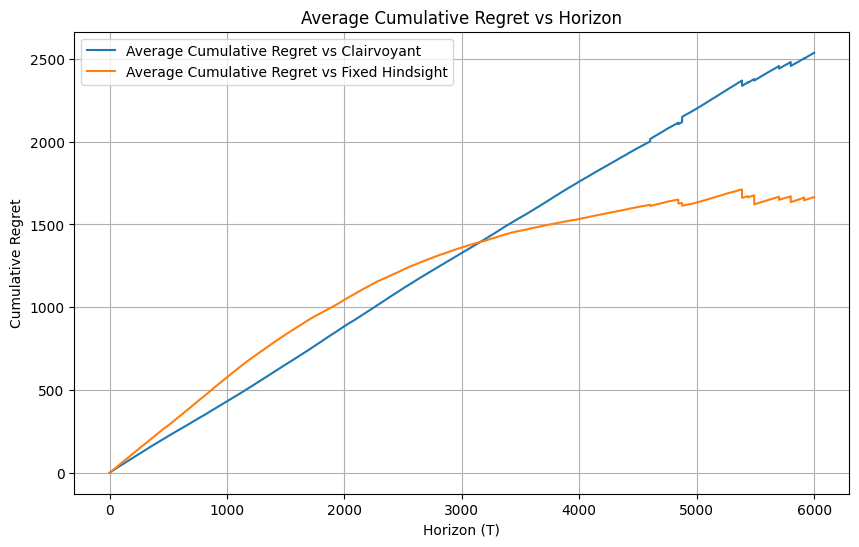

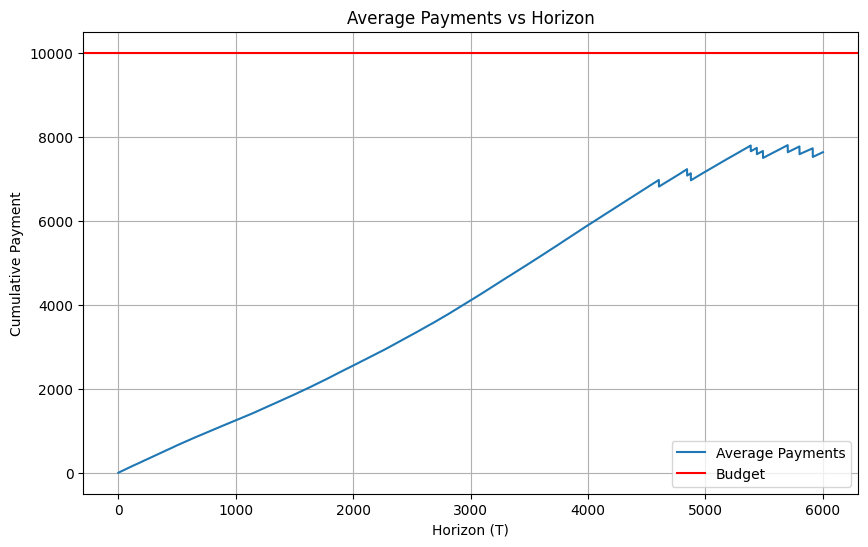

In [39]:
plot_regret_vs_horizon(all_regrets, all_regrets_fixed_hind, horizons)
plot_payments_vs_horizon(all_payments, horizons, budget)

#### 10 Prices (K = 10)

##### Multiple trials with horizons

In [ ]:
run_one = 0
products = ['A','B','C']
budget = 10000
T = 6000
seeds = [10123, 47281, 39502, 86734, 19285, 55012, 73190, 28461, 61027, 90834,
         45712, 67209, 31845, 82650, 14029, 59384, 71203, 40917, 28495, 63721]

fixed_prices = 1

if fixed_prices:
  K=10
  prices_per_product = np.linspace(0.01, 1, K)    
  # prices_per_product = np.array([0, 0.05, 0.1, 0.15, 0.20, 0.25, 0.30, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0])
else:
  epsilon = T ** (-0.33)
  K = int(1 / epsilon)
  prices_per_product = np.linspace(0.01, 1, K)    

print(f'Discretizing prices with {K} values')
print(prices_per_product)
prices = {p: prices_per_product for p in products}
print(prices)


means = np.array([0.2, 0.5, 0.7])
covs = 0.01*np.array([[1., 0.3, 0.1],
                       [0.2, 1., 0.],
                       [0.5, 0.5, 1]])

# eta = T**(-0.5) 
eta = T**(-0.7)
if run_one:
    utilities, _, _, clairv_util, fixed_hind_clair, history = run_single_trial_viz(0, products, prices, prices_per_product, budget, T, eta, K, means, covs, seed=89, n_viz_rounds=T)

    cum_utilities = np.cumsum(utilities)
    cum_clairv = np.cumsum(clairv_util)
    cum_clairv_fixed_hind = np.cumsum(fixed_hind_clair)

    avg_regret = cum_clairv - cum_utilities
    avg_regret_fixed_hind = cum_clairv_fixed_hind - cum_utilities

    plt.figure(figsize=(10,6))
    plt.plot(avg_regret, label='Average Cumulative Regret')
    plt.plot(avg_regret_fixed_hind, label='Average Cumulative Regret (Fixed, Hindsight)')
    plt.xlabel('Rounds')
    plt.ylabel('Cumulative Regret')
    plt.title('Average Regret vs Oracle over Multiple Trials')
    plt.legend()
    plt.show()

else:
    all_regrets, all_regrets_fixed_hind, all_payments, horizons,_ = run_all_trials_parallel_horizon(
    seeds, products, prices, prices_per_product, budget, T, eta, K, means, covs, n_jobs=-1
    )

Discretizing prices with 10 values
[0.01 0.12 0.23 0.34 0.45 0.56 0.67 0.78 0.89 1.  ]
{'A': array([0.01, 0.12, 0.23, 0.34, 0.45, 0.56, 0.67, 0.78, 0.89, 1.  ]), 'B': array([0.01, 0.12, 0.23, 0.34, 0.45, 0.56, 0.67, 0.78, 0.89, 1.  ]), 'C': array([0.01, 0.12, 0.23, 0.34, 0.45, 0.56, 0.67, 0.78, 0.89, 1.  ])}


Trial 1:   0%|          | 0/6000 [00:00<?, ?it/s]









Trial 1:   0%|          | 1/6000 [00:00<48:27,  2.06it/s]








Trial 1:   0%|          | 19/6000 [00:00<02:20, 42.53it/s]









Trial 1:   1%|          | 37/6000 [00:00<01:19, 75.27it/s]









Trial 1:   1%|          | 54/6000 [00:00<01:00, 98.76it/s]









Trial 1:   1%|          | 71/6000 [00:00<00:50, 116.85it/s]









Trial 1:   1%|▏         | 88/6000 [00:01<00:45, 129.55it/s]









Trial 1:   2%|▏         | 107/6000 [00:01<00:40, 144.99it/s]









Trial 1:   2%|▏         | 124/6000 [00:01<00:43, 133.58it/s]









Trial 1:   2%|▏         | 139/6000 [00:01<00:42, 136.41it/s]









Trial 1:   3%|▎         | 156/6000 [00:01<00:40, 144.51it/s]









Trial 1:   3%|▎         | 174/6000 [00:01<00:37, 153.71it/s]









Trial 1:   3%|▎         | 192/6000 [00:01<00:36, 158.17it/s]









Trial 1:   4%|▎         | 211/6000 [00:01<00:35, 165.09it/s]









Trial 1:   4%|▍         | 230/6000 [00:01<0

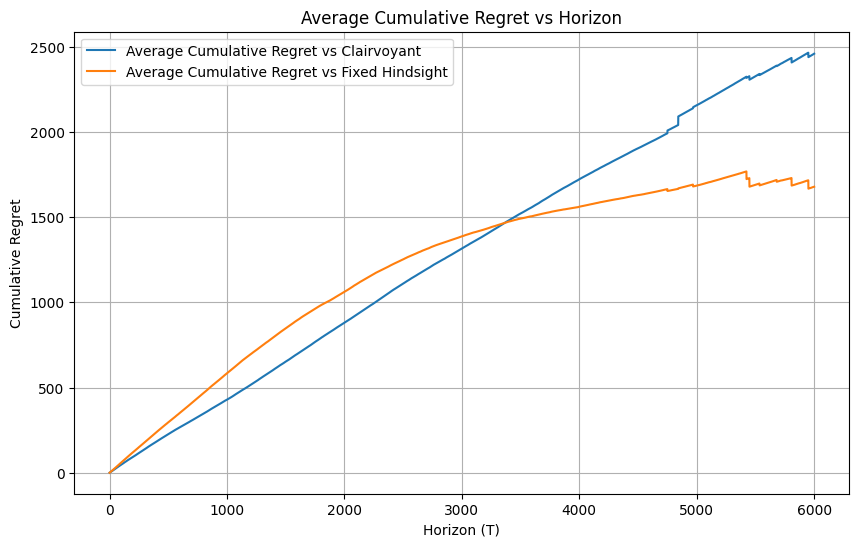

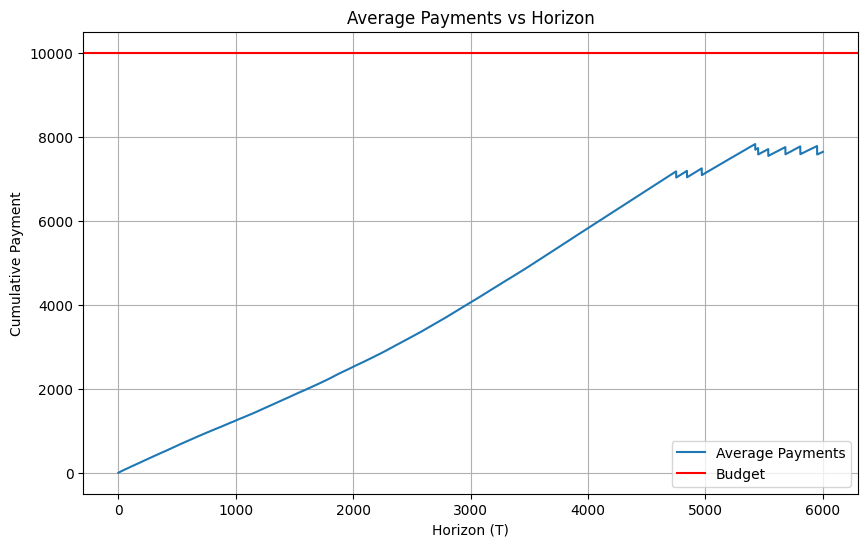

In [41]:
plot_regret_vs_horizon(all_regrets, all_regrets_fixed_hind, horizons)
plot_payments_vs_horizon(all_payments, horizons, budget)